In [4]:
%matplotlib inline
import os, json
import numpy as np
import skimage.io as sio
from matplotlib import pyplot as plt
import glob

### Visualize Images

In [5]:
%matplotlib inline
import os, json
import numpy as np
import skimage.io as sio
from matplotlib import pyplot as plt
import glob

def plankton_labels():
    # Load all specimens
    specimen_list = ['_'.join (fn.split ('/')[-2:]) for fn in
                     glob.glob ('/data4/plankton_wi17/plankton/images_orig/*/*')]

    # Load all labels
    specimen_labels = [l.split (',') for l in open ('/data5/Plankton_wi18/rawcolor_db2/classes/specimen_taxonomy.txt').read ().splitlines ()[1:]]
    specimen_labels = {l[0]: l[1:] for l in specimen_labels if not l[0].startswith ('google')}
    for spc in specimen_list:
        if spc not in specimen_labels:
            specimen_labels[spc] = ['Unknown'] * 3

    return specimen_labels

def group_specimen2class(imgList):
    specimenIDs = [img.split('/')[0] for img in imgList]
    planktonLabels = plankton_labels()

    specimenSet = {spc: [spc] for spc in set(specimenIDs)}     # Specimen Lvl
    genus = [planktonLabels[spc][2] for spc in specimenIDs]
    genusSet = {cls: [spc for spc in specimenIDs if planktonLabels[spc][2] == cls] for cls in set(genus)}   # Genus Lvl
    family = [planktonLabels[spc][1] for spc in specimenIDs]
    familySet = {cls: [spc for spc in specimenIDs if planktonLabels[spc][1]==cls] for cls in set(family)}   # Family Lvl
    order = [planktonLabels[spc][0] for spc in specimenIDs]
    orderSet = {cls: [spc for spc in specimenIDs if planktonLabels[spc][0]==cls] for cls in set(order)}   # Order Lvl
    dataSet = {'Dataset': specimenIDs}
    return {'Species':specimenSet, 'Genus':genusSet, 'Family':familySet, 'Order':orderSet,'Dataset':dataSet}, specimenIDs

specimen_list = sorted(os.listdir('/data5/Plankton_wi18/rawcolor_db2/images'))
taxLvlDatasets, specimenIDs = group_specimen2class(specimen_list)

specimen_list = taxLvlDatasets['Order']['Cyclopoida'] + taxLvlDatasets['Order']['Calanoida']
for i, spc in enumerate(specimen_list):
    images_fn = open('/data5/Plankton_wi18/rawcolor_db2/subsets/{}-timeseries.lst'.format(spc)).read().splitlines()
    meta = json.load(open('/data5/Plankton_wi18/rawcolor_db2/meta/{}-meta.json'.format(spc)))
    meta = meta[images_fn[0]]
    
    print '\n{:03d}/{:03d}: {} {} {} {}'.format(i+1, len(specimen_list), spc, meta['order'], meta['family'], meta['genus'])
    f, axarray = plt.subplots(1, 5, figsize=(20, 4))
    for j in range(5):
        fn = images_fn[int(j/5.*len(images_fn))]
        img = plt.imread(os.path.join('/data5/Plankton_wi18/rawcolor_db2', 'images', fn))
        axarray[j].imshow(img)
        axarray[j].set_axis_off()
        axarray[j].set_title(fn.split('/')[-1][9:30])
    plt.show()


001/132: 20170124_001 Amphipoda Gammaridae Gammaridae (family)


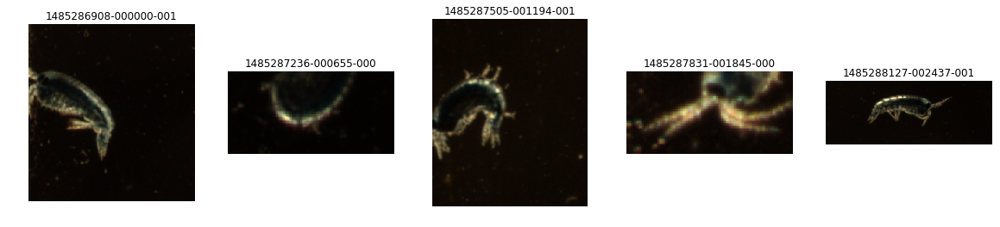


002/132: 20170124_002 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


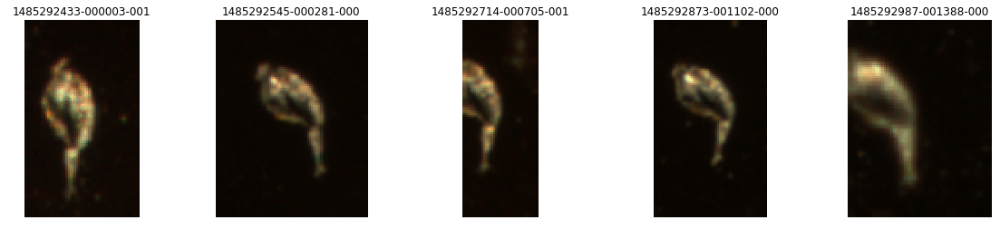


003/132: 20170126_001 Appendicularia (class) Appendicularia (class) Appendicularia (class)


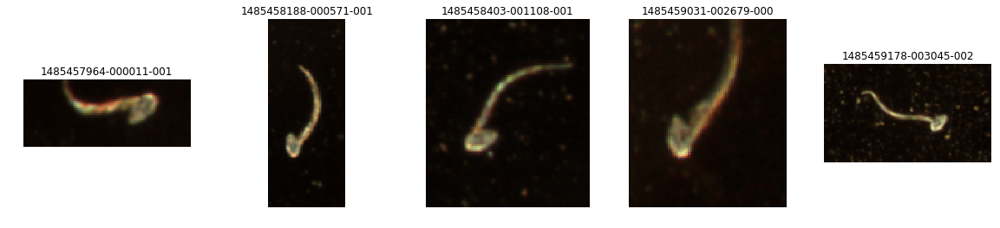


004/132: 20170126_002 Mysida Mysida (order) Mysida (order)


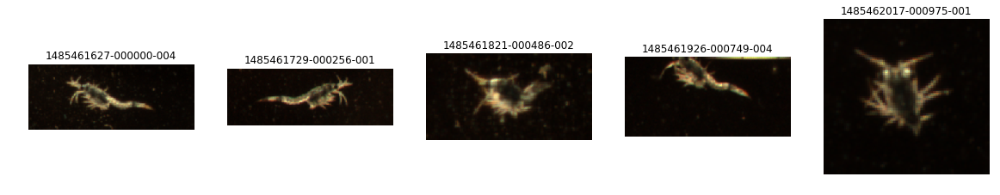


005/132: 20170126_003 Calanoida Calanoida (order) Calanoida (order)


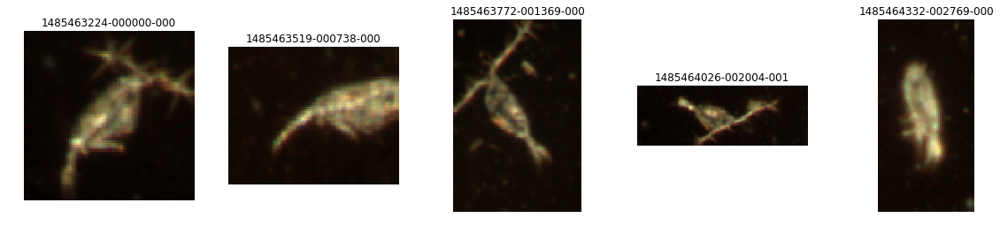


006/132: 20170130_001 Calanoida Calanidae Calanus


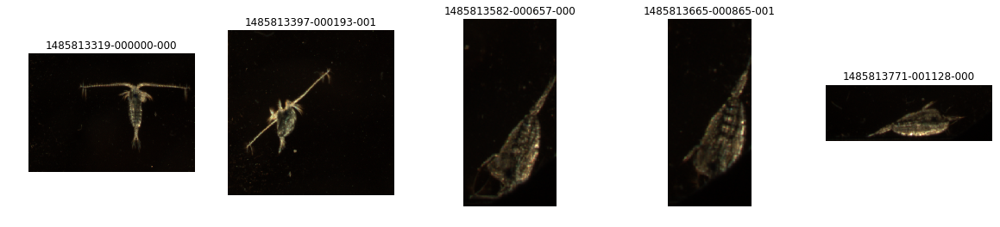


007/132: 20170130_002 Mysida Mysida (order) Mysida (order)


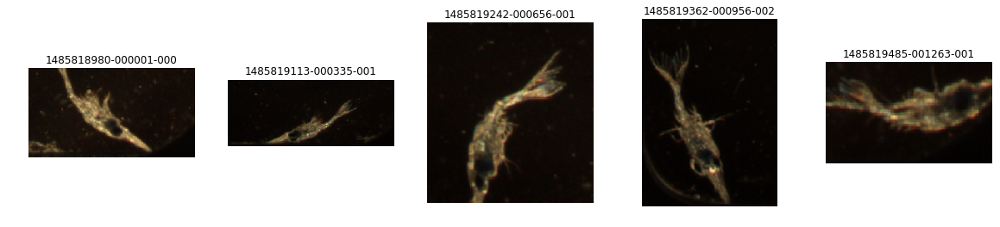


008/132: 20170130_003 Decapoda Brachyura Brachyura (family)


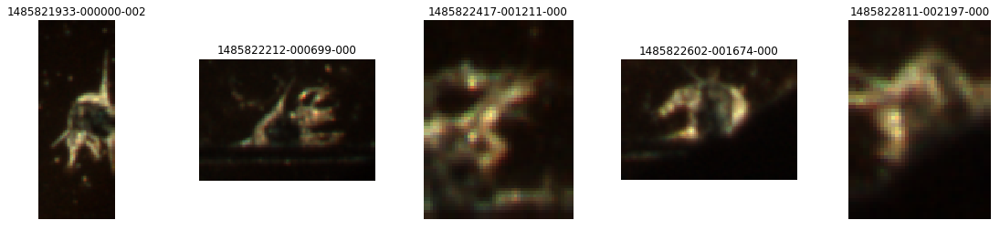


009/132: 20170131_001 Saggittoidea (class) Saggittoidea (class) Saggittoidea (class)


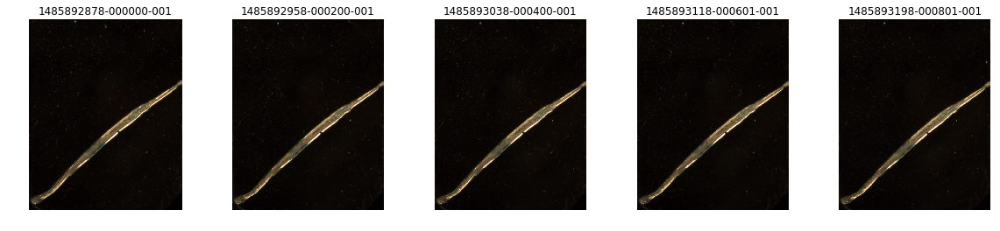


010/132: 20170131_002 Mysida Mysida (order) Mysida (order)


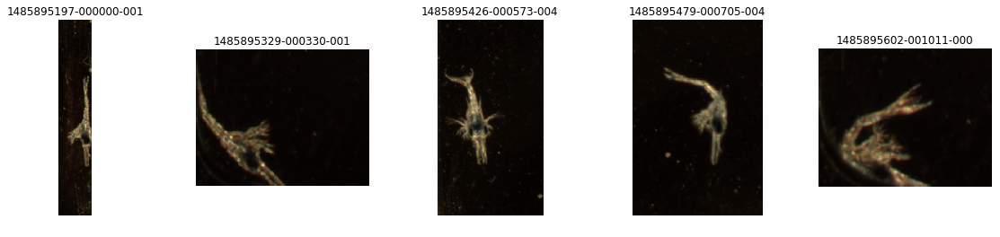


011/132: 20170203_001 Calanoida Calanoida (order) Calanoida (order)


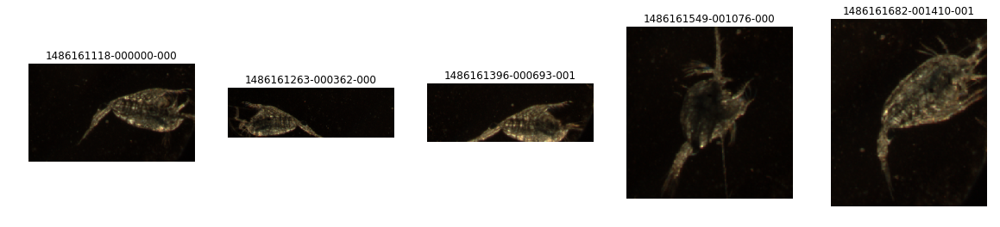


012/132: 20170203_002 Ostracoda (class) Ostracoda (class) Ostracoda (class)


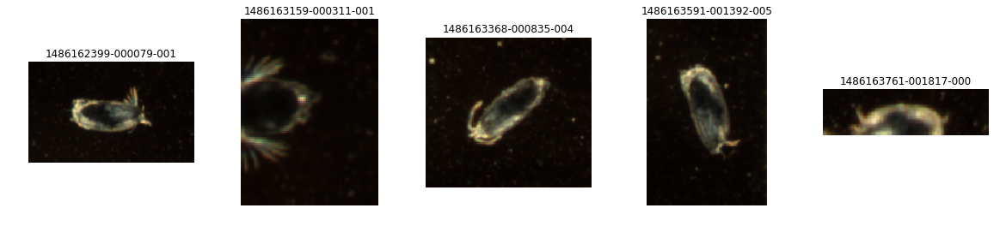


013/132: 20170206_001 Polychaeta (class) Polychaeta (class) Polychaeta (class)


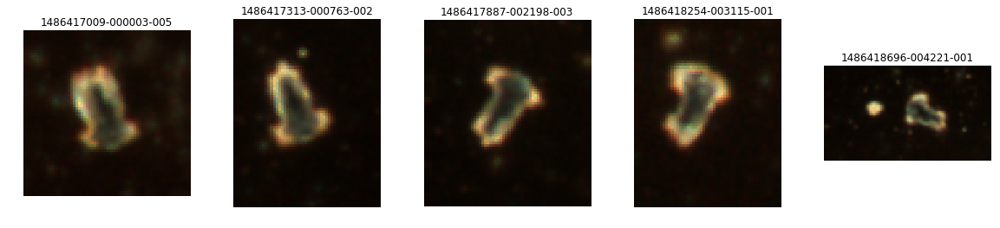


014/132: 20170206_002 Euphausiacea Euphausiidae Euphausiidae (family)


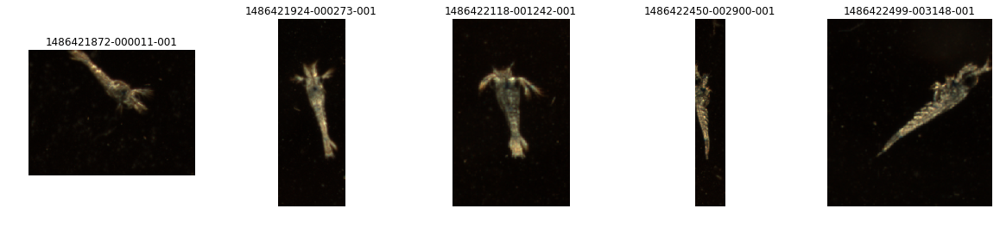


015/132: 20170207_001 Calanoida Calanoida (order) Calanoida (order)


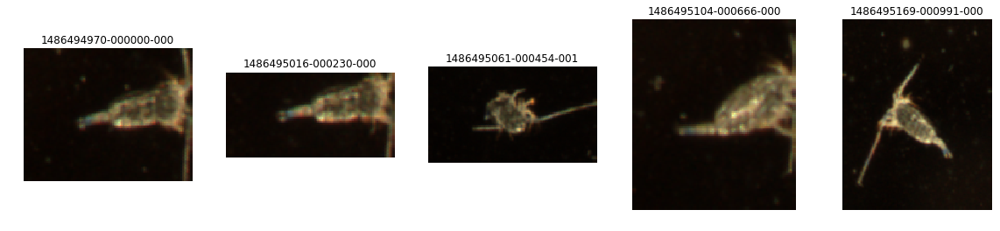


016/132: 20170207_003 Cydippida Cydippida (order) Cydippida (order)


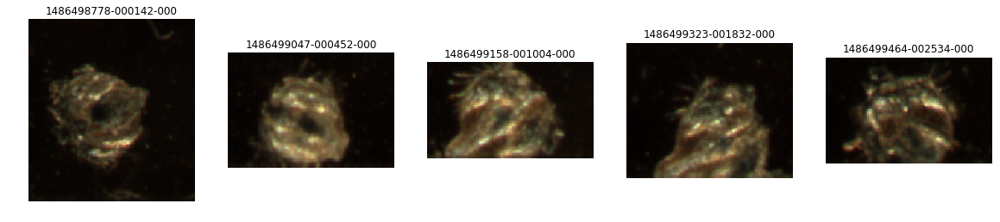


017/132: 20170207_004 Siphonophorae Diphyidae Diphyidae (family)


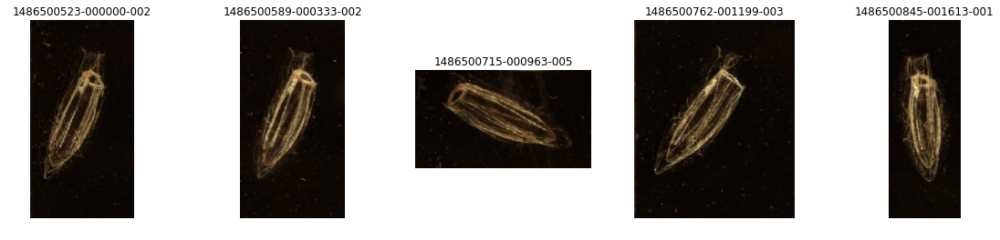


018/132: 20170207_006 Euphausiacea Euphausiidae Euphausiidae (family)


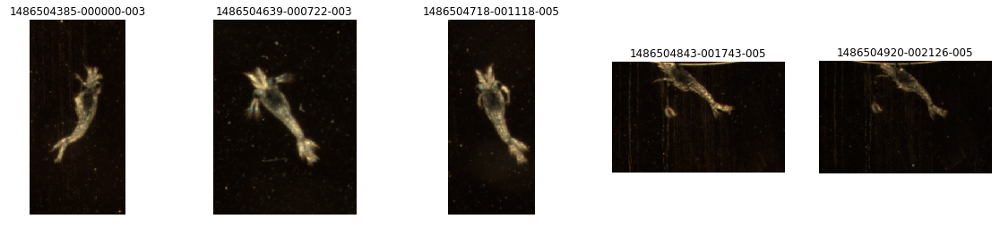


019/132: 20170209_001 Calanoida Calanoida (order) Calanoida (order)


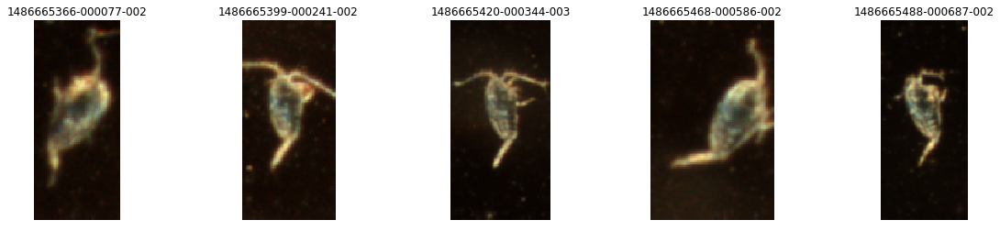


020/132: 20170209_002 Calanoida Pontellidae Pontellidae (family)


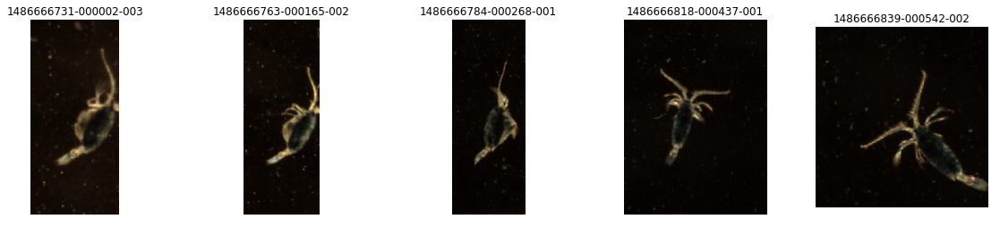


021/132: 20170209_003 Ostracoda (class) Ostracoda (class) Ostracoda (class)


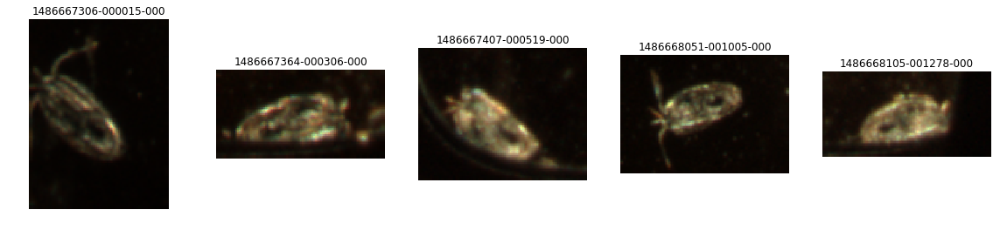


022/132: 20170210_001 Cydippida Cydippida (order) Cydippida (order)


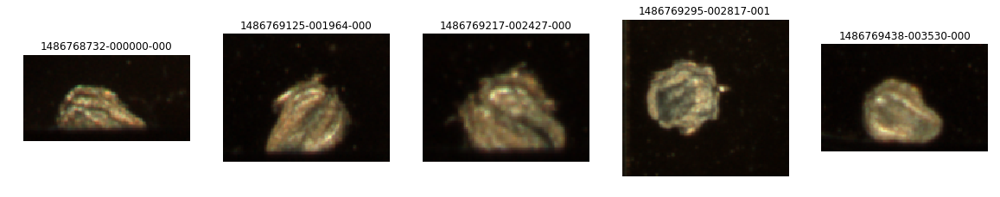


023/132: 20170210_002 Hydromedusae Hydromedusae (order) Hydromedusae (order)


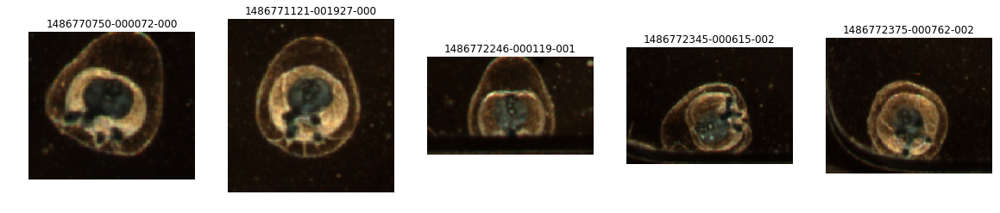


024/132: 20170213_001 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


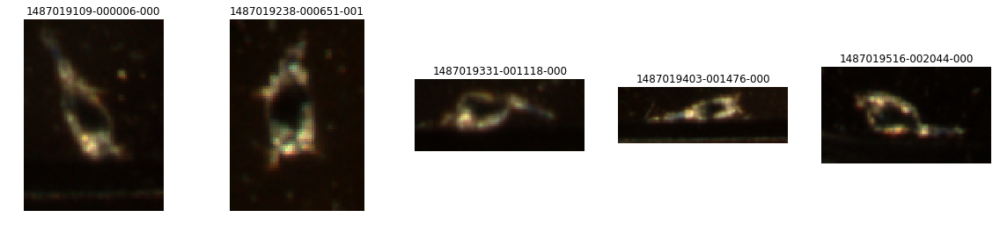


025/132: 20170213_002 Hydromedusae Hydromedusae (order) Hydromedusae (order)


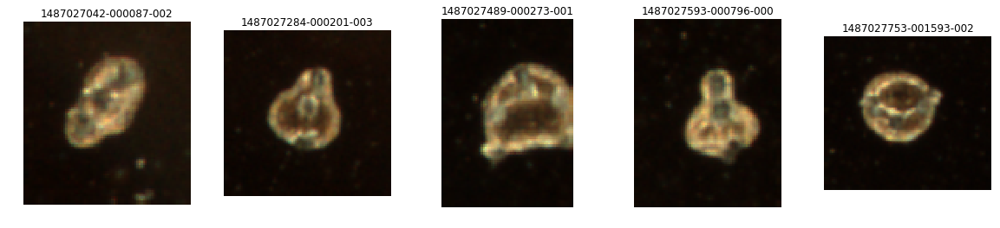


026/132: 20170213_003 Calanoida Calanoida (order) Calanoida (order)


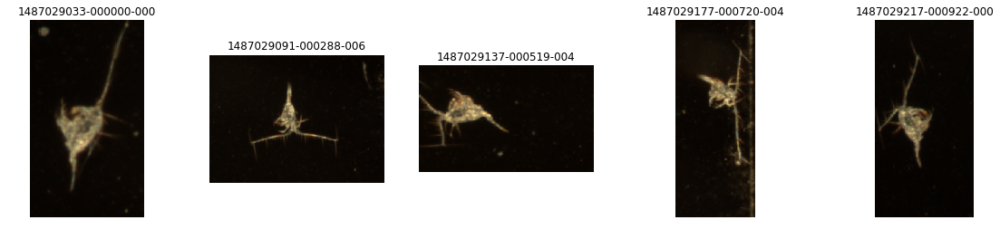


027/132: 20170214_001 Decapoda Brachyura Brachyura (family)


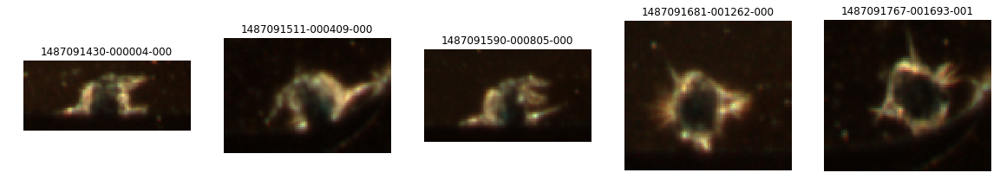


028/132: 20170214_002 Calanoida Calanoida (order) Calanoida (order)


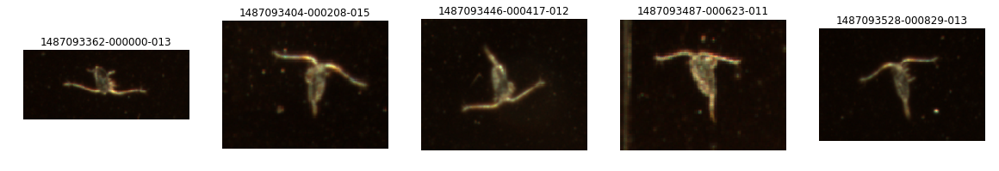


029/132: 20170214_003 Calanoida Calanoida (order) Calanoida (order)


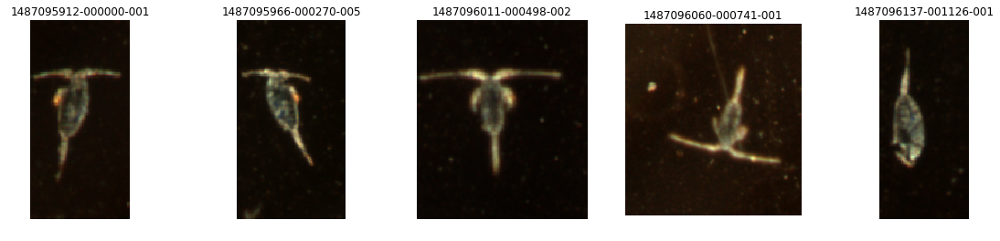


030/132: 20170214_004 Amphipoda Gammaridae Gammaridae (family)


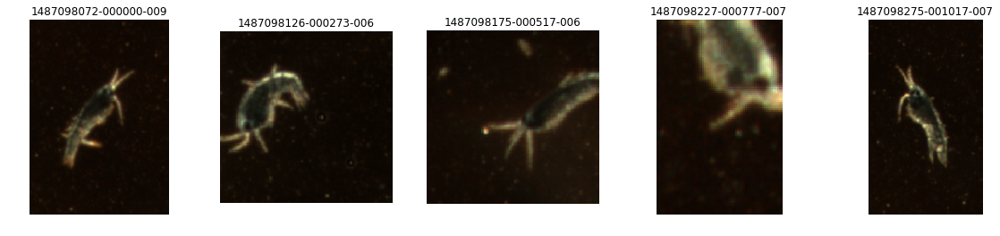


031/132: 20170214_005 Calanoida Calanoida (order) Calanoida (order)


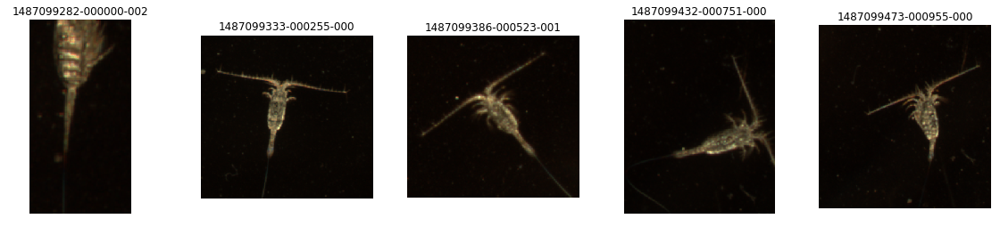


032/132: 20170214_006 Unknown Unknown Unknown


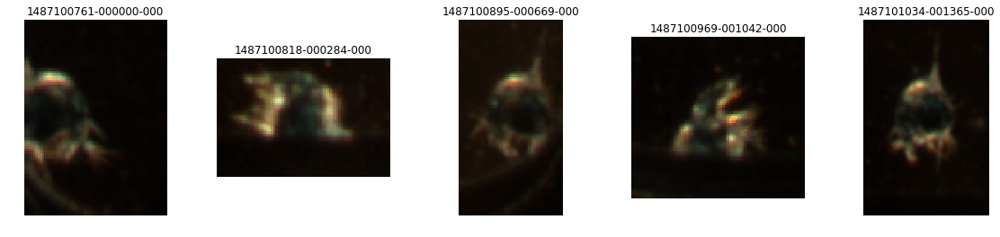


033/132: 20170216_001 Cyclopoida Oithonidae Oithonidae (family)


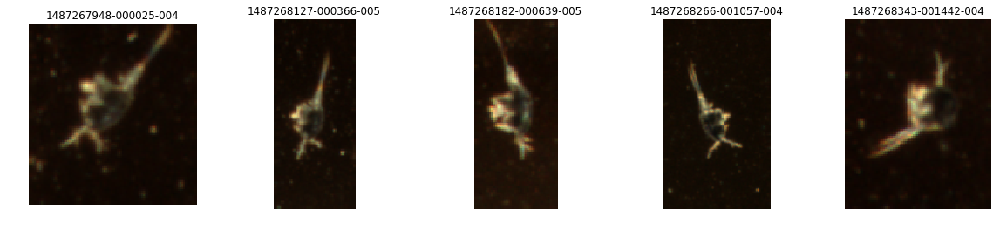


034/132: 20170216_002 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


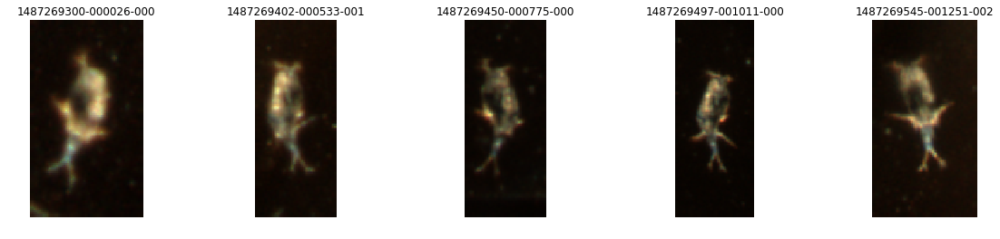


035/132: 20170216_003 Hydromedusae Hydromedusae (order) Hydromedusae (order)


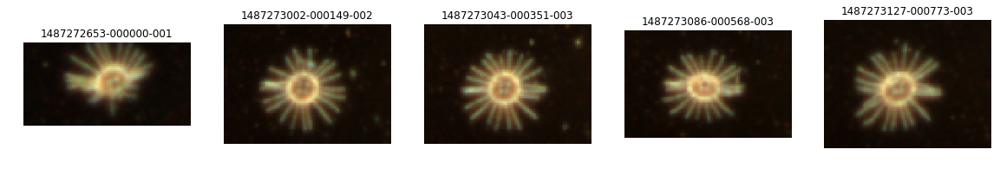


036/132: 20170216_004 Cyclopoida Oithonidae Oithonidae (family)


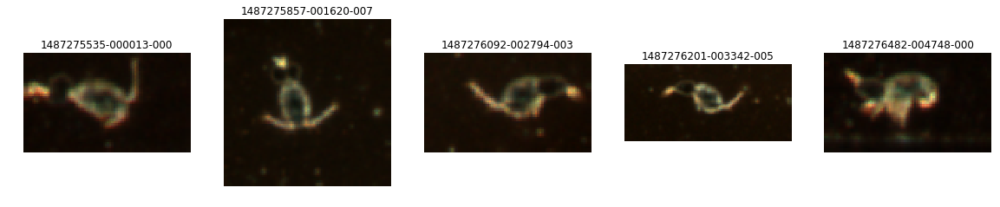


037/132: 20170216_005 Calanoida Calanoida (order) Calanoida (order)


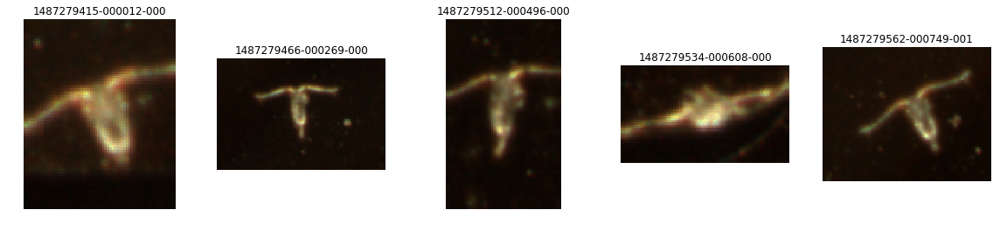


038/132: 20170216_006 Unknown Unknown Unknown


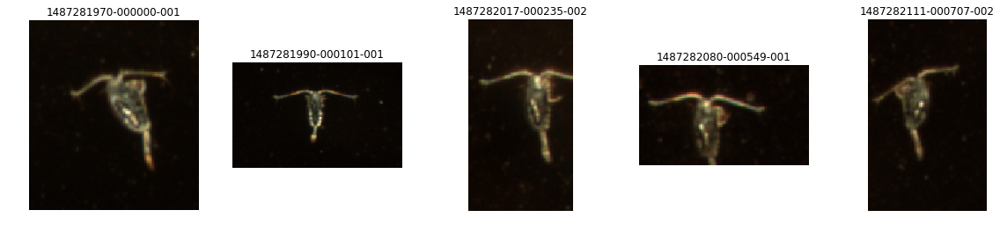


039/132: 20170217_001 Calanoida Acartiidae Acartiidae (family)


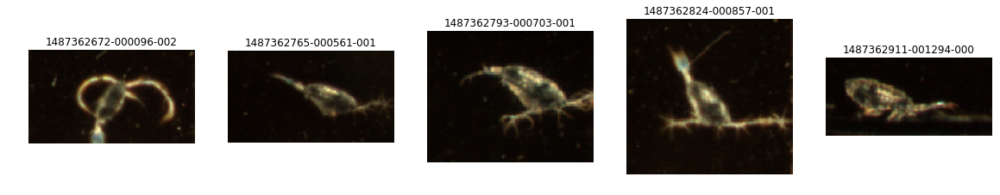


040/132: 20170217_002 Calanoida Acartiidae Acartiidae (family)


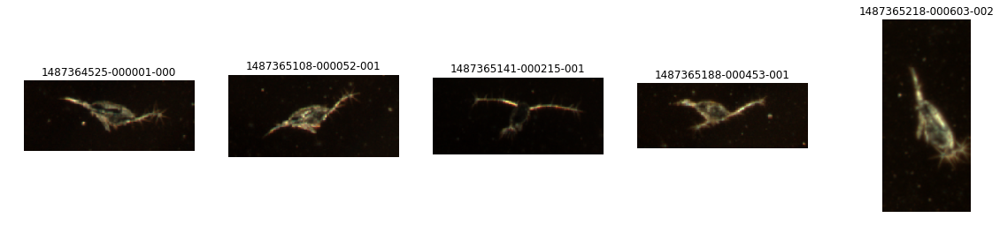


041/132: 20170217_003 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


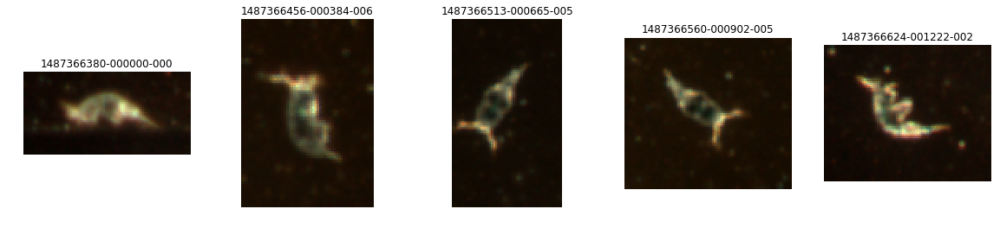


042/132: 20170217_004 Calanoida Calanoida (order) Calanoida (order)


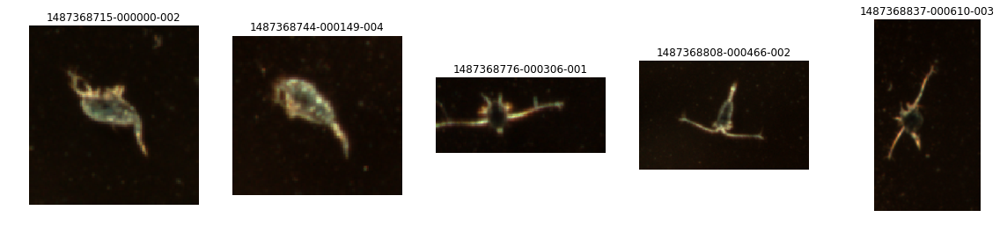


043/132: 20170217_005 Polychaeta (class) Polychaeta (class) Polychaeta (class)


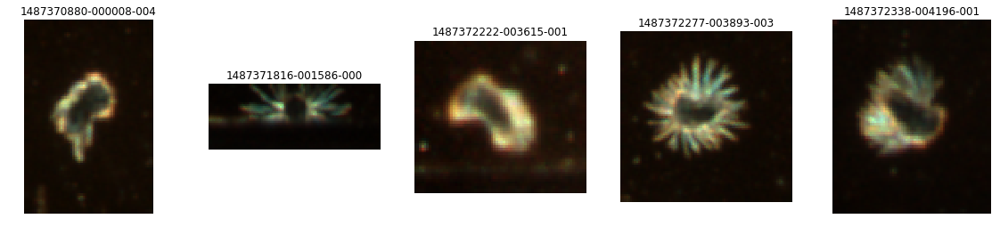


044/132: 20170217_006 Cyclopoida Oithonidae Oithonidae (family)


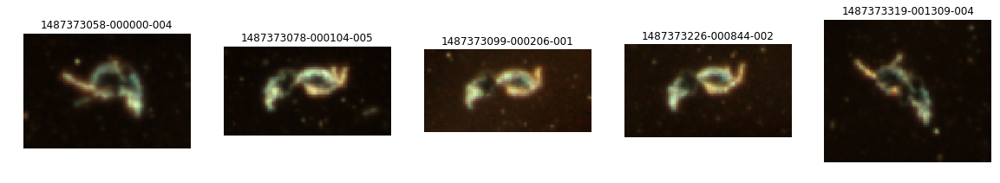


045/132: 20170217_007 Unknown Unknown Unknown


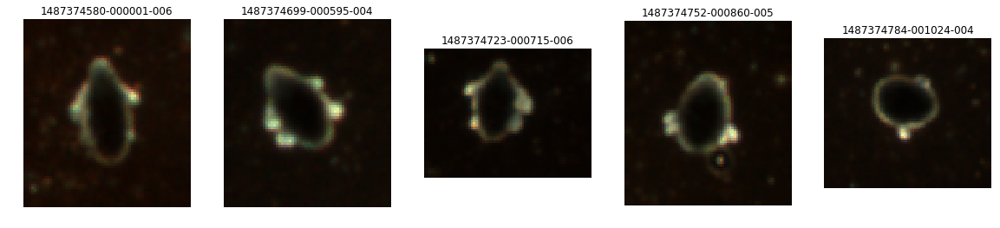


046/132: 20170221_001 Decapoda Brachyura Brachyura (family)


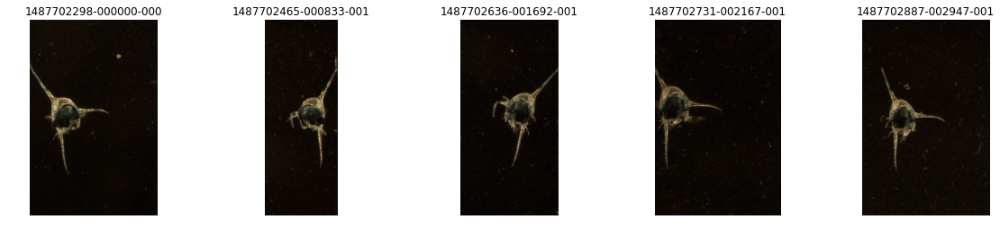


047/132: 20170221_002 Euphausiacea Euphausiidae Euphausiidae (family)


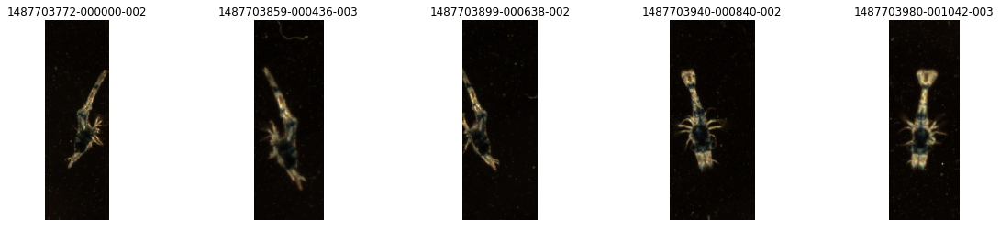


048/132: 20170221_003 Decapoda Brachyura Brachyura (family)


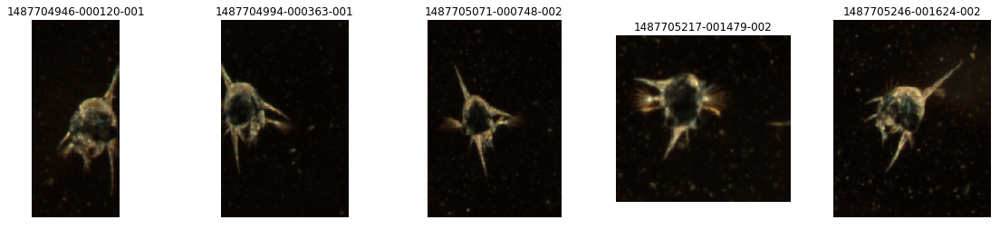


049/132: 20170221_004 Decapoda Brachyura Brachyura (family)


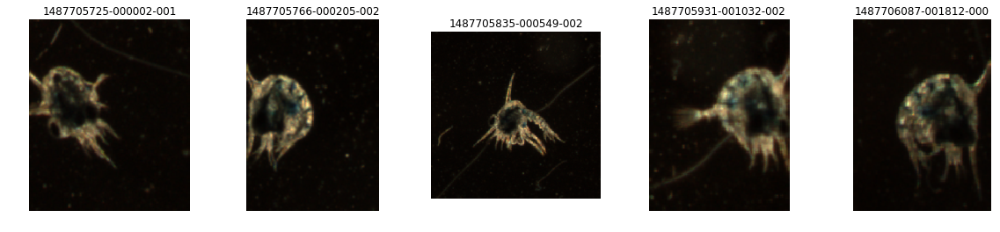


050/132: 20170221_005 Decapoda Brachyura Brachyura (family)


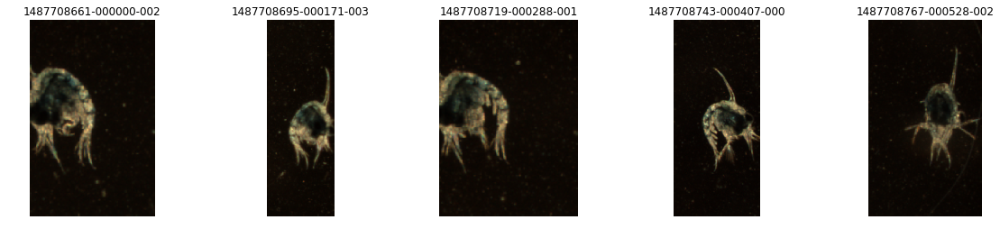


051/132: 20170221_006 Hydromedusae Hydromedusae (order) Hydromedusae (order)


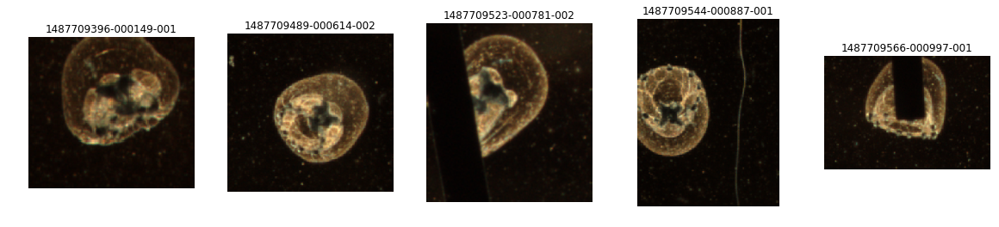


052/132: 20170221_007 Hydromedusae Hydromedusae (order) Hydromedusae (order)


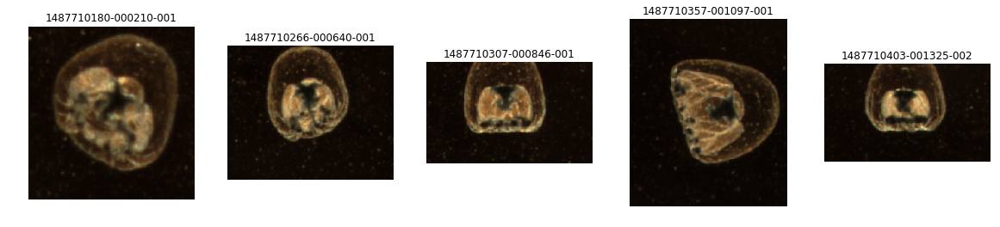


053/132: 20170223_001 Calanoida Calanoida (order) Calanoida (order)


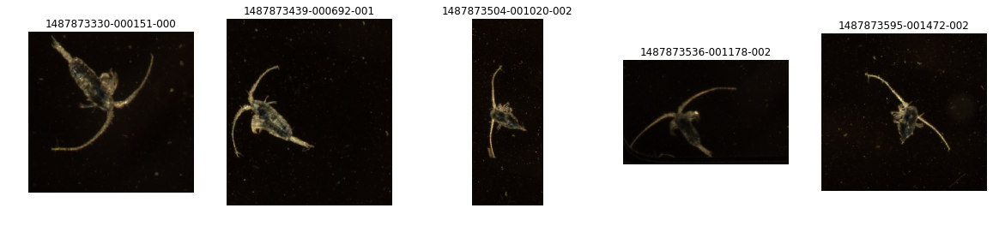


054/132: 20170223_002 Calanoida Tortanidae Tortanus


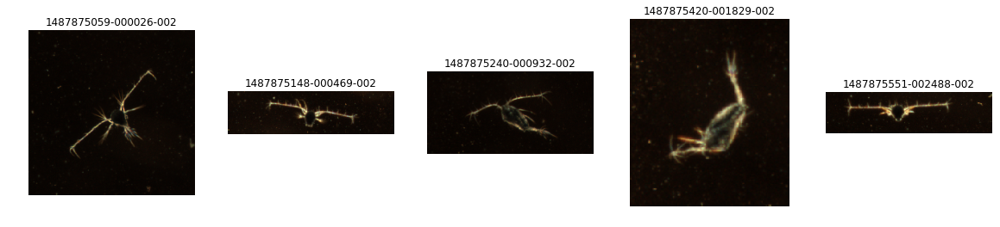


055/132: 20170224_001 Polychaeta (class) Polychaeta (class) Polychaeta (class)


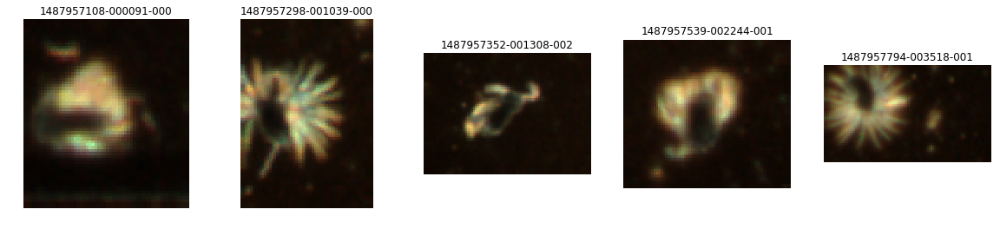


056/132: 20170224_002 Hydromedusae Hydromedusae (order) Hydromedusae (order)


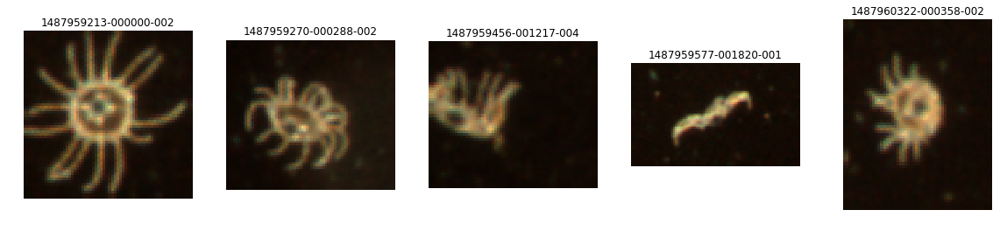


057/132: 20170224_003 Polychaeta (class) Polychaeta (class) Polychaeta (class)


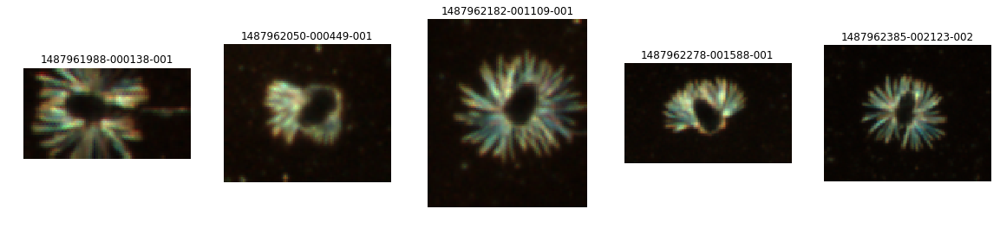


058/132: 20170224_004 Cyclopoida Oithonidae Oithonidae (family)


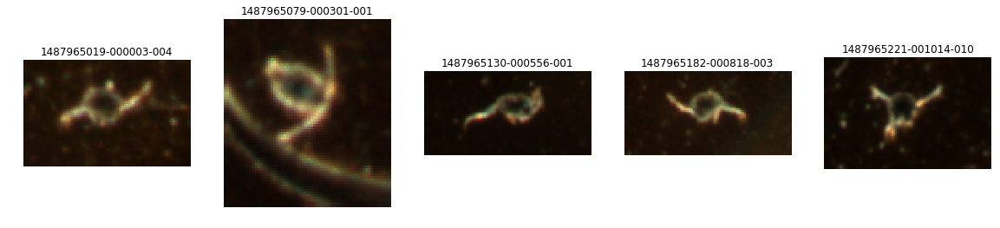


059/132: 20170224_005 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


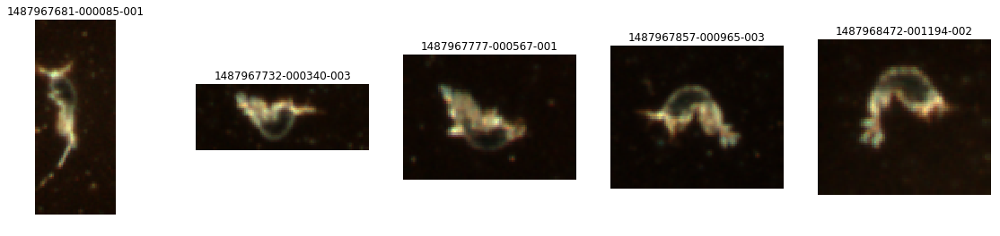


060/132: 20170224_006 Hydromedusae Hydromedusae (order) Hydromedusae (order)


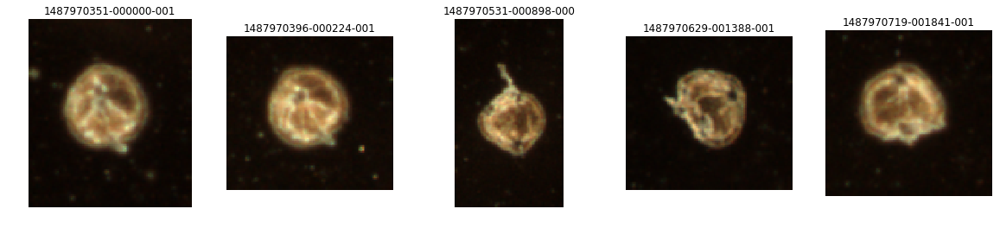


061/132: 20170224_007 Hydromedusae Hydromedusae (order) Hydromedusae (order)


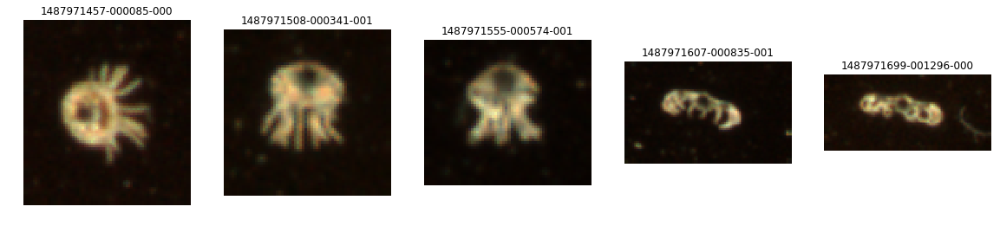


062/132: 20170224_008 Hydromedusae Hydromedusae (order) Hydromedusae (order)


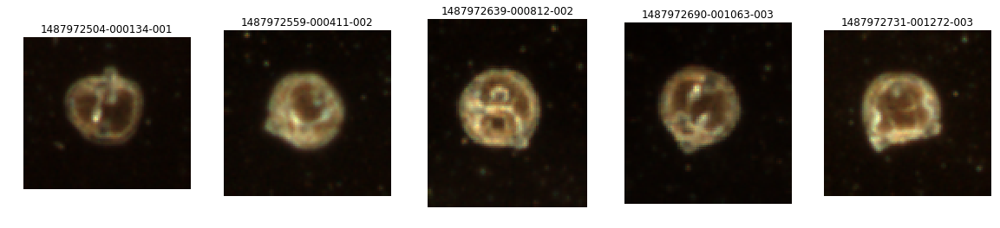


063/132: 20170224_009 Hydromedusae Hydromedusae (order) Hydromedusae (order)


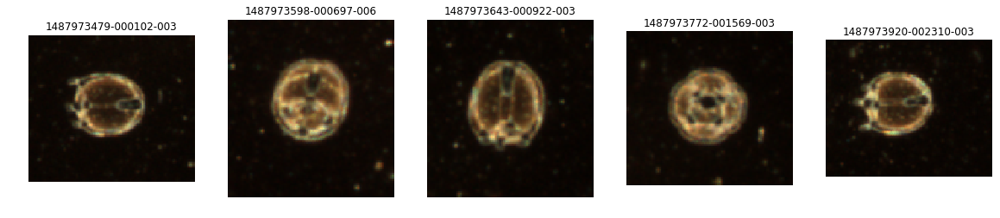


064/132: 20170224_010 Calanoida Calanoida (order) Calanoida (order)


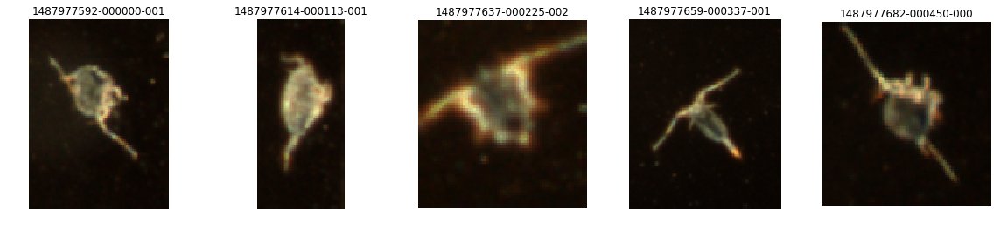


065/132: 20170224_011 Hydromedusae Hydromedusae (order) Hydromedusae (order)


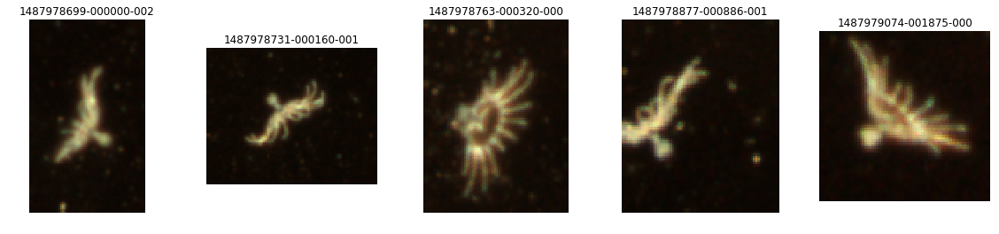


066/132: 20170224_012 Copepoda Nauplia (subclass) Copepoda Nauplia (subclass) Copepoda Nauplia (subclass)


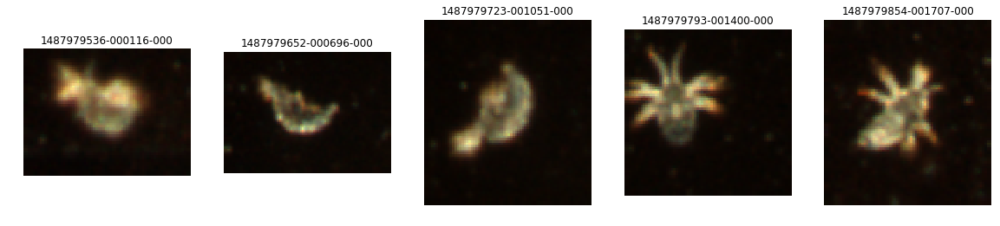


067/132: 20170228_001 Unknown Unknown Unknown


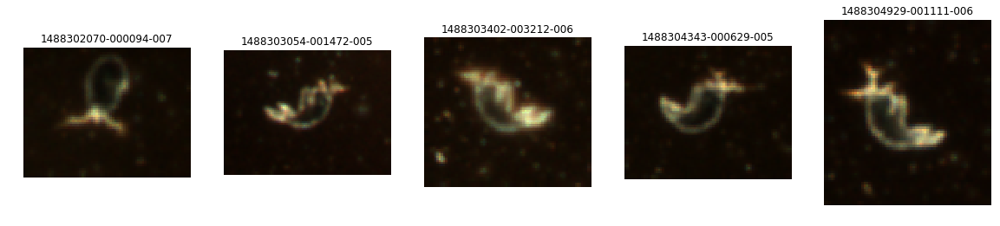


068/132: 20170228_002 Unknown Unknown Unknown


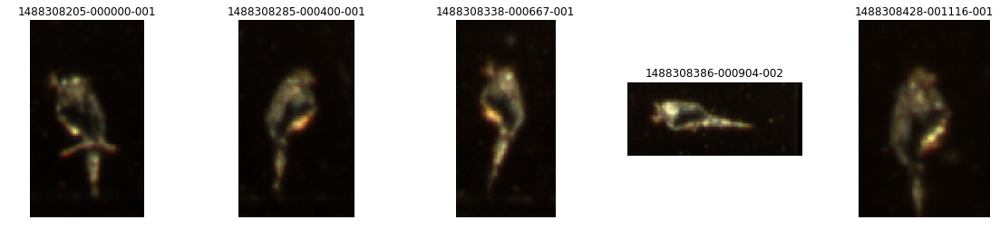


069/132: 20170228_003 Unknown Unknown Unknown


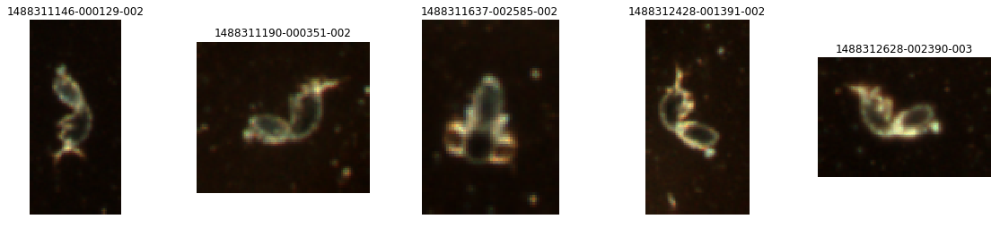


070/132: 20170302_001 Calanoida Acartiidae Acartiidae (family)


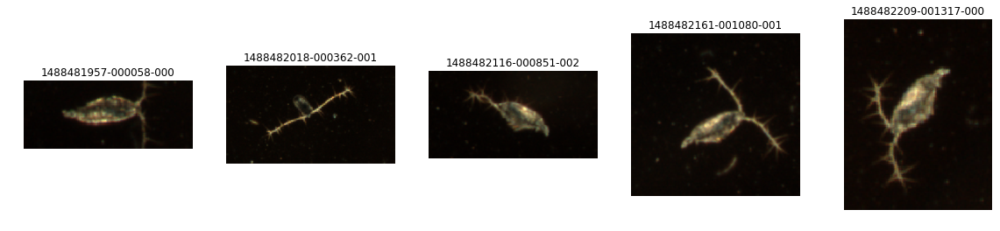


071/132: 20170302_002 Polychaeta (class) Polychaeta (class) Polychaeta (class)


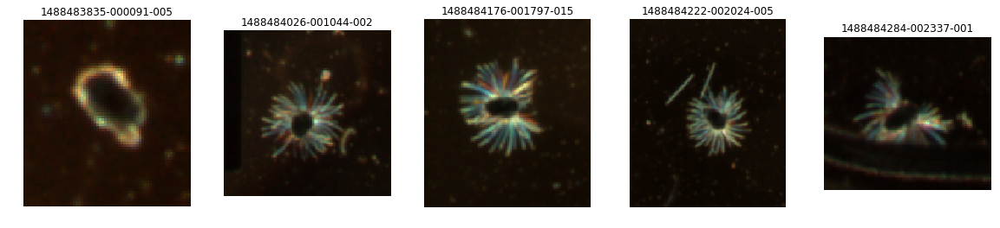


072/132: 20170303_001 Polychaeta (class) Polychaeta (class) Polychaeta (class)


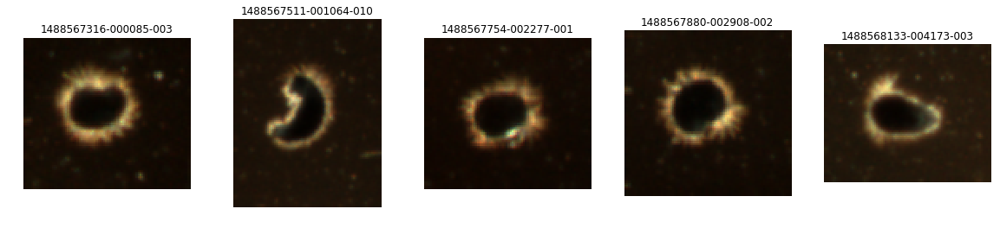


073/132: 20170303_002 Polychaeta (class) Polychaeta (class) Polychaeta (class)


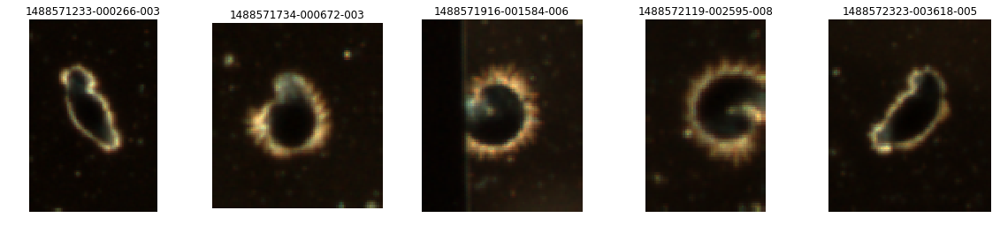


074/132: 20170303_003 Hydromedusae Hydromedusae (order) Hydromedusae (order)


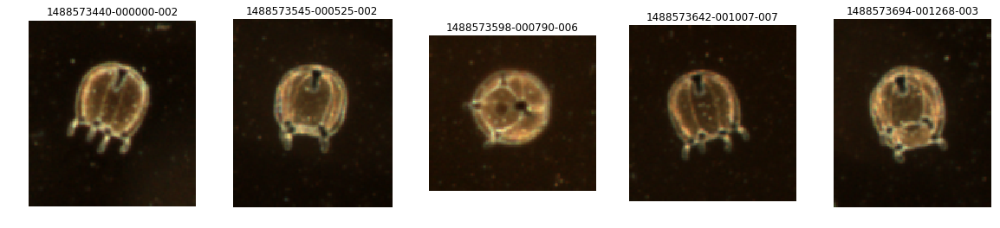


075/132: 20170303_004 Calanoida Calanoida (order) Calanoida (order)


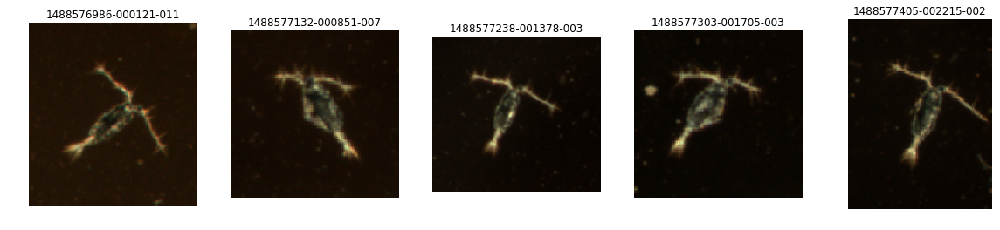


076/132: 20170303_005 Calanoida Calanoida (order) Calanoida (order)


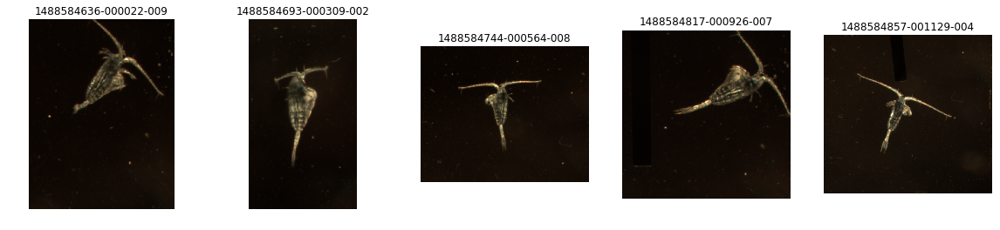


077/132: 20170306_001 Amphipoda Gammaridae Gammaridae (family)


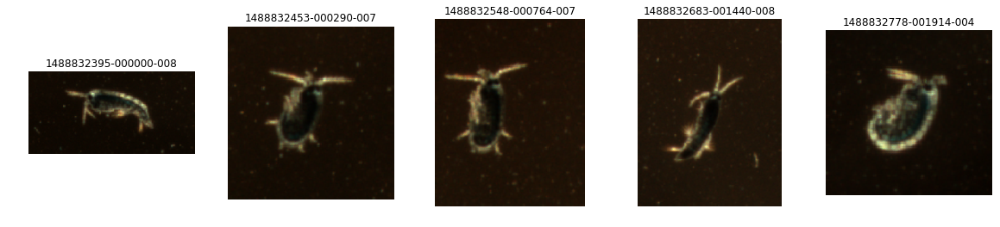


078/132: 20170306_002 Amphipoda Gammaridae Gammaridae (family)


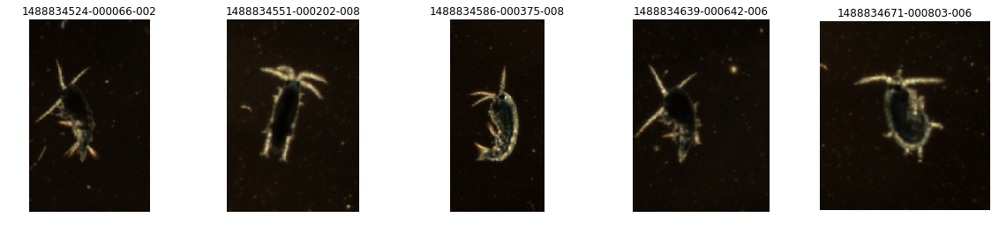


079/132: 20170306_003 Unknown Unknown Unknown


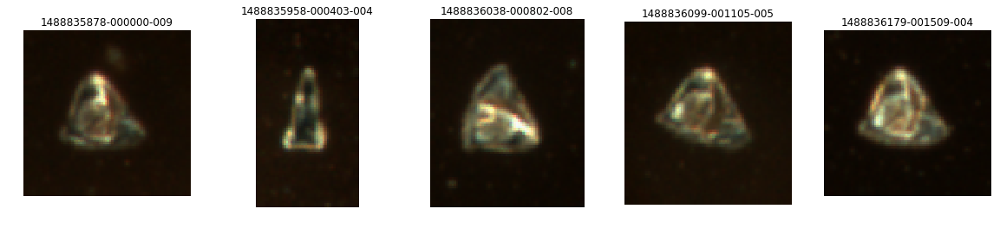


080/132: 20170306_004 Calanoida Calanoida (order) Calanoida (order)


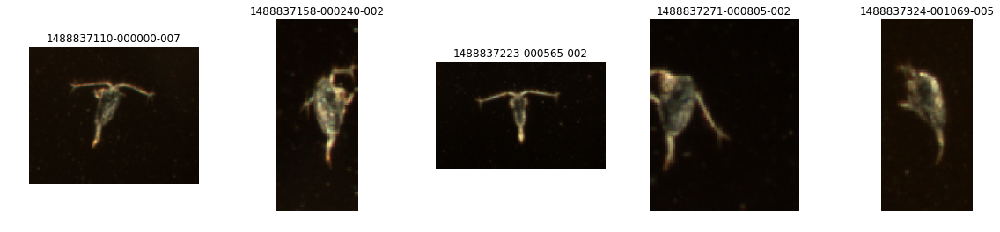


081/132: 20170306_005 Calanoida Calanoida (order) Calanoida (order)


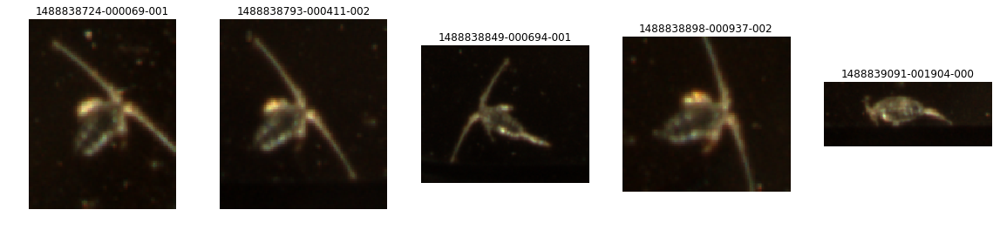


082/132: 20170306_006 Calanoida Calanoida (order) Calanoida (order)


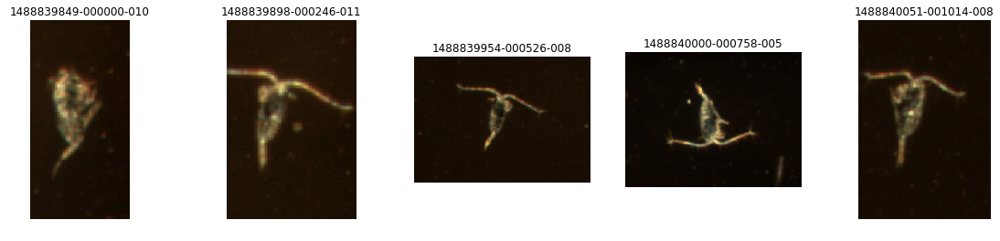


083/132: 20170306_007 Amphipoda Gammaridae Gammaridae (family)


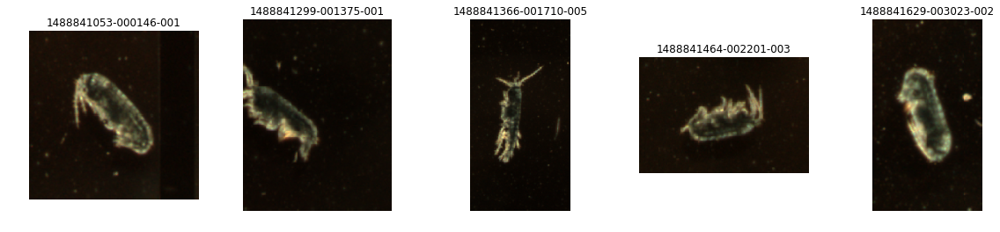


084/132: 20170307_001 Amphipoda Gammaridae Gammaridae (family)


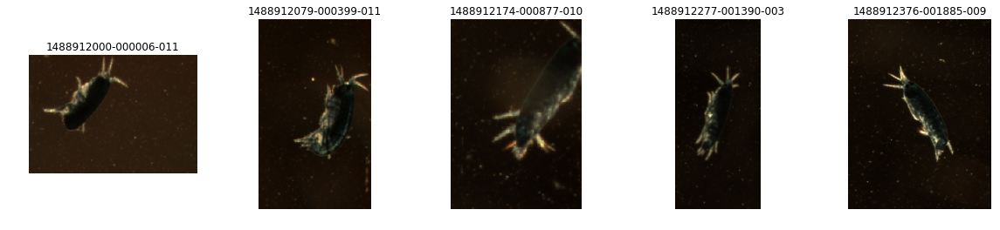


085/132: 20170307_002 Calanoida Calanoida (order) Calanoida (order)


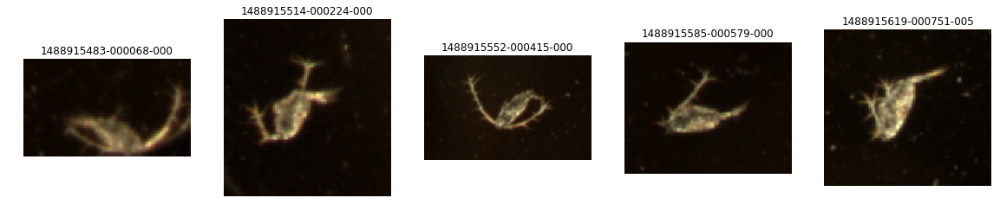


086/132: 20170307_003 Amphipoda Gammaridae Gammaridae (family)


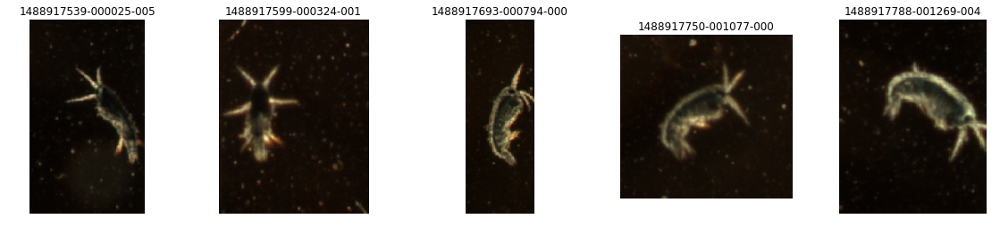


087/132: 20170420_001 Appendicularia (class) Appendicularia (class) Appendicularia (class)


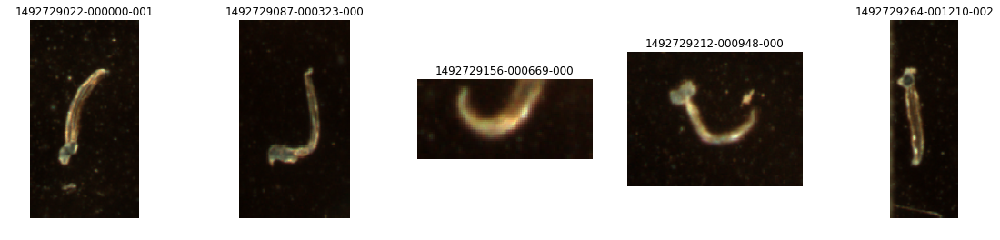


088/132: 20170425_001 Polychaeta (class) Polychaeta (class) Polychaeta (class)


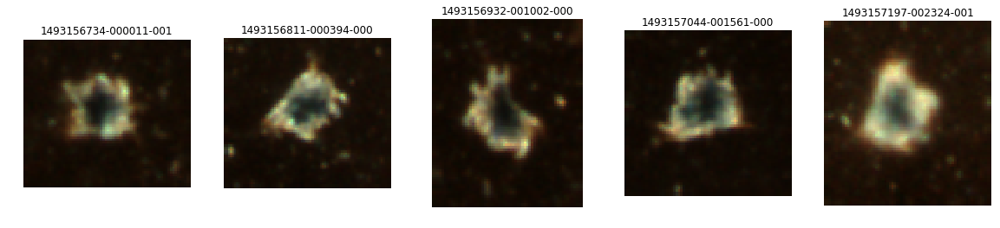


089/132: 20170425_002 Calanoida Acartiidae Acartiidae (family)


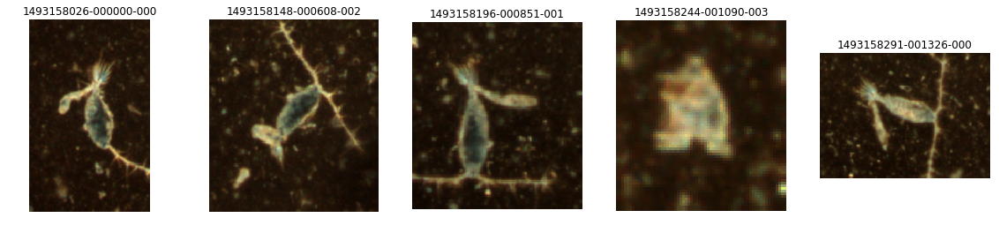


090/132: 20170425_003 Calanoida Calanoida (order) Calanoida (order)


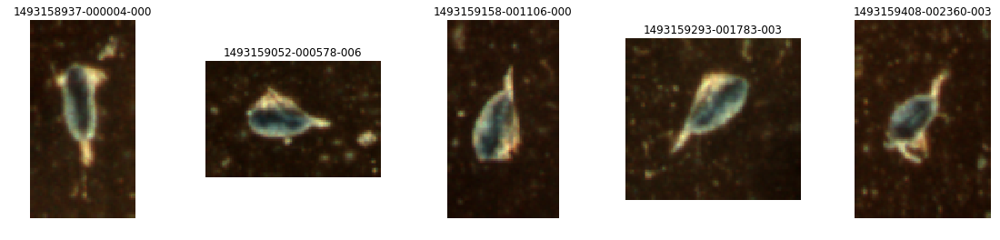


091/132: 20170425_004 Calanoida Calanoida (order) Calanoida (order)


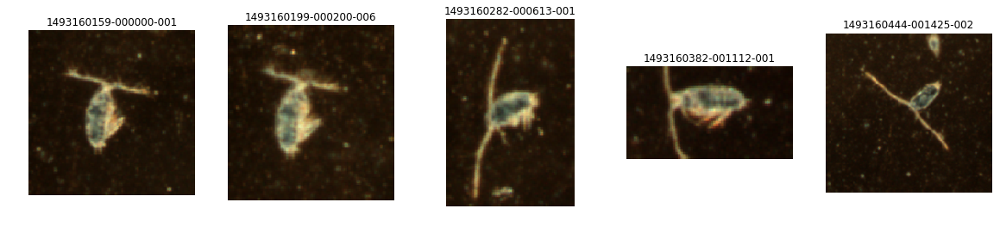


092/132: 20170425_005 Calanoida Calanoida (order) Calanoida (order)


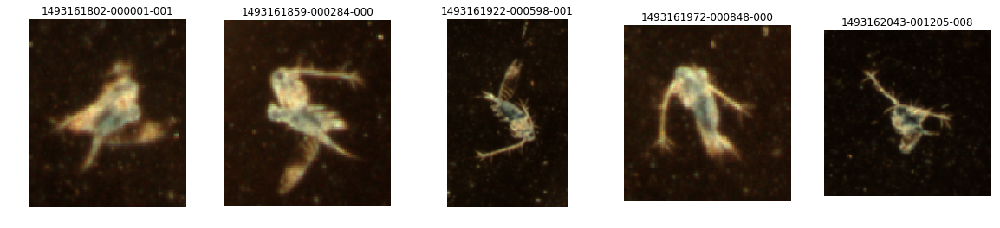


093/132: 20170427_001 Unknown Unknown Unknown


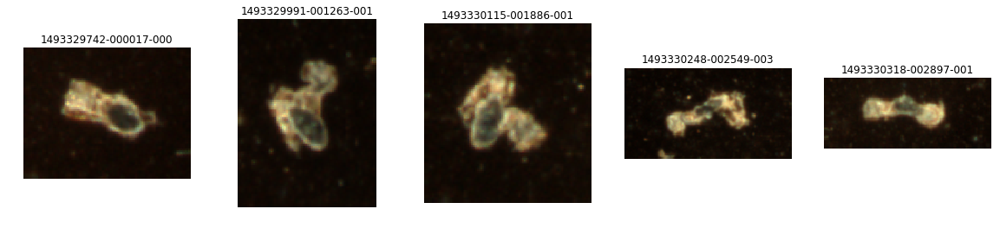


094/132: 20170427_002 Calanoida Calanoida (order) Calanoida (order)


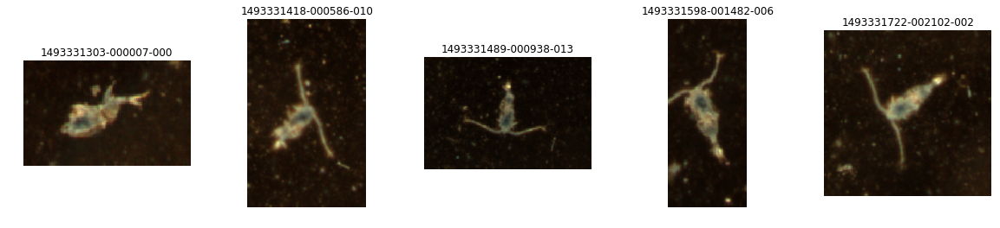


095/132: 20170427_003 Amphipoda Gammaridae Gammaridae (family)


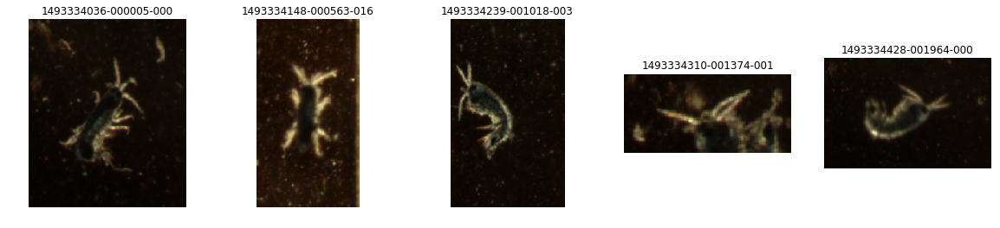


096/132: 20170427_004 Calanoida Calanoida (order) Calanoida (order)


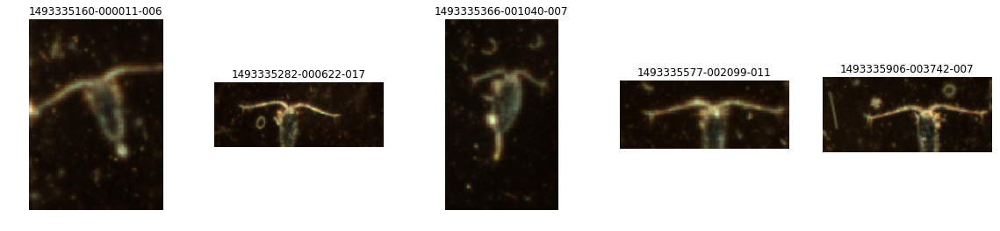


097/132: 20170502_001 Unknown Unknown Unknown


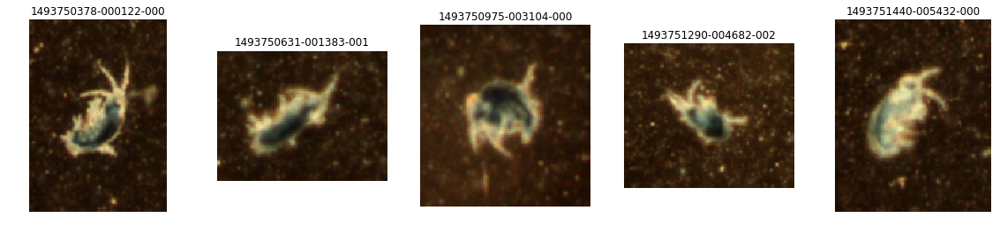


098/132: 20170502_002 Amphipoda Gammaridae Gammaridae (family)


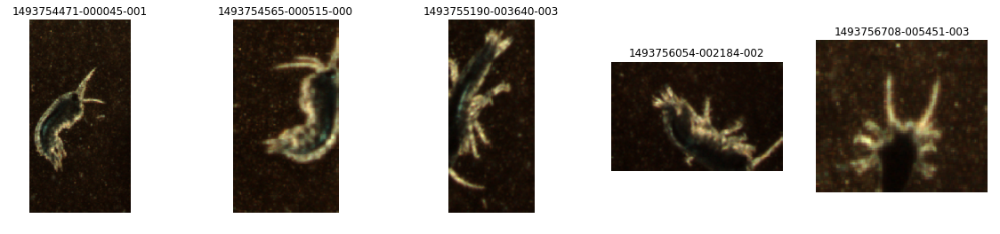


099/132: 20170504_001 Polychaeta (class) Polychaeta (class) Polychaeta (class)


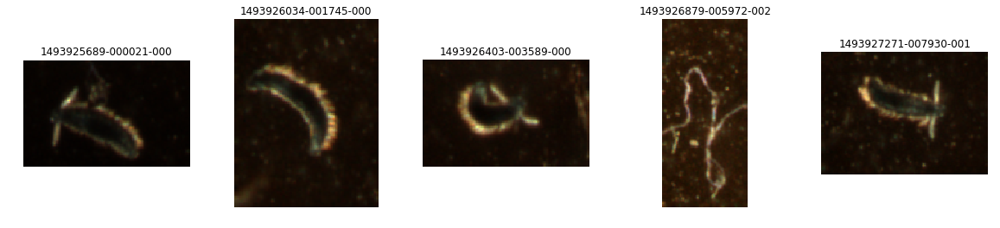


100/132: 20170504_002 Calanoida Calanoida (order) Calanoida (order)


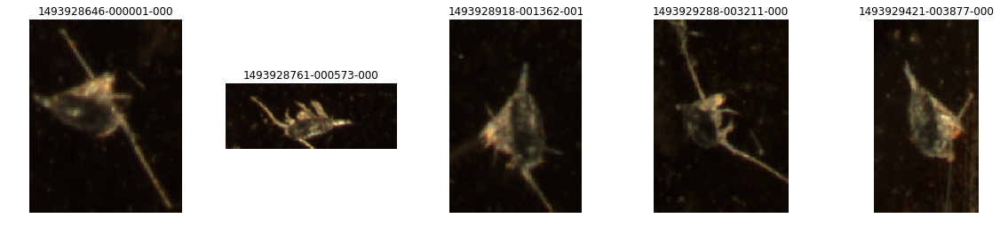


101/132: 20170504_003 Calanoida Calanoida (order) Calanoida (order)


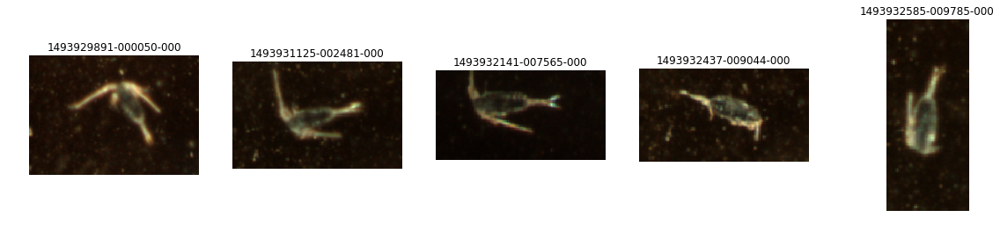


102/132: 20170504_004 Polychaeta (class) Polychaeta (class) Polychaeta (class)


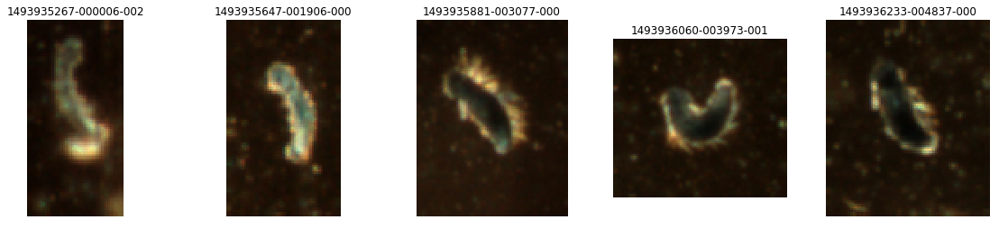


103/132: 20170504_005 Unknown Unknown Unknown


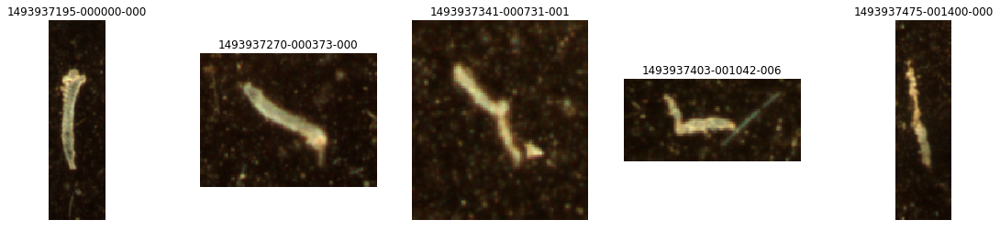


104/132: 20170504_006 Euphausiacea Euphausiidae Euphausiidae (family)


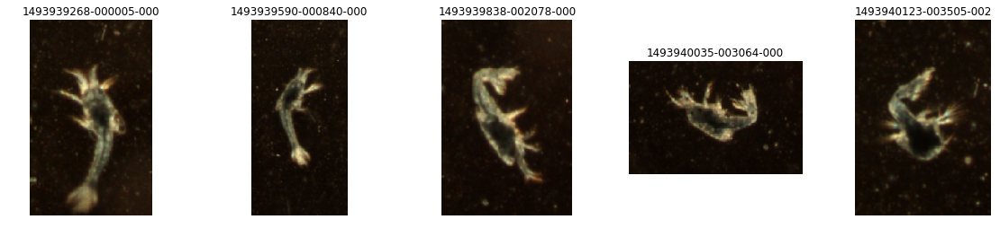


105/132: 20170504_007 Calanoida Calanoida (order) Calanoida (order)


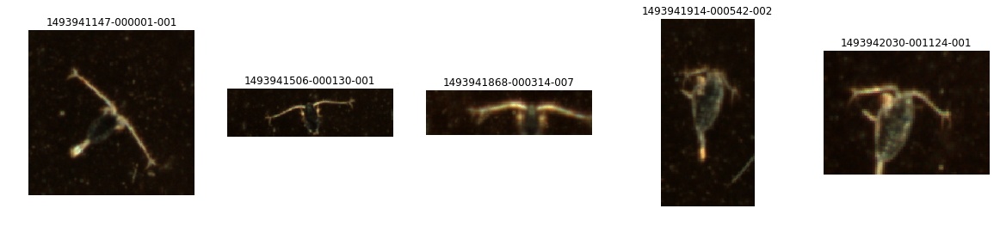


106/132: 20170509_001 Calanoida Calanoida (order) Calanoida (order)


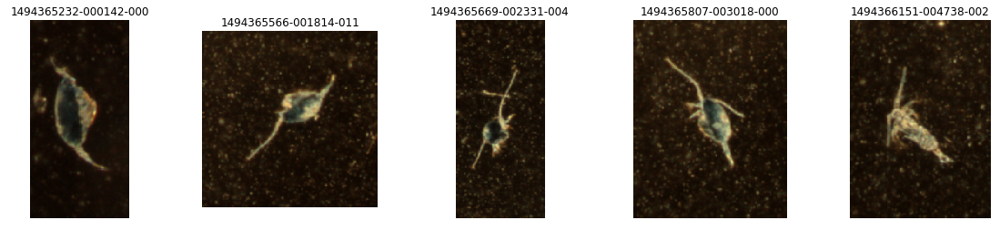


107/132: 20170509_002 Polychaeta (class) Polychaeta (class) Polychaeta (class)


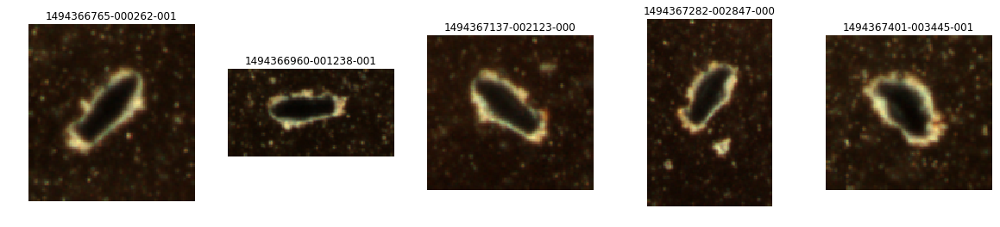


108/132: 20170509_003 Polychaeta (class) Polychaeta (class) Polychaeta (class)


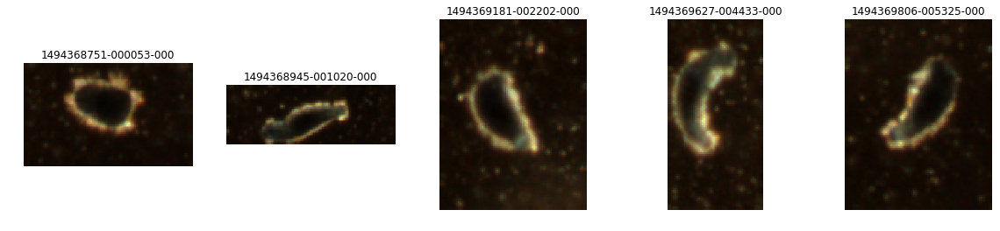


109/132: 20170509_004 Cyclopoida Oithonidae Oithonidae (family)


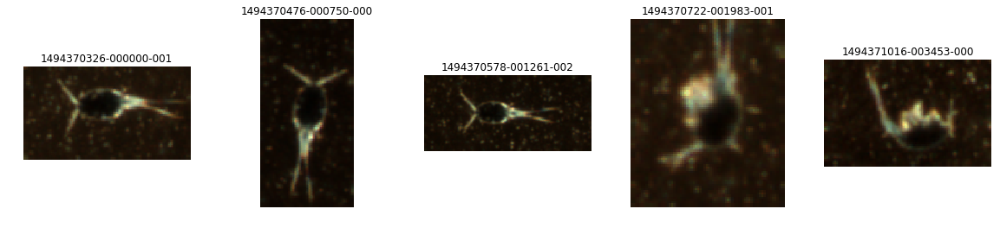


110/132: 20170509_005 Unknown Unknown Unknown


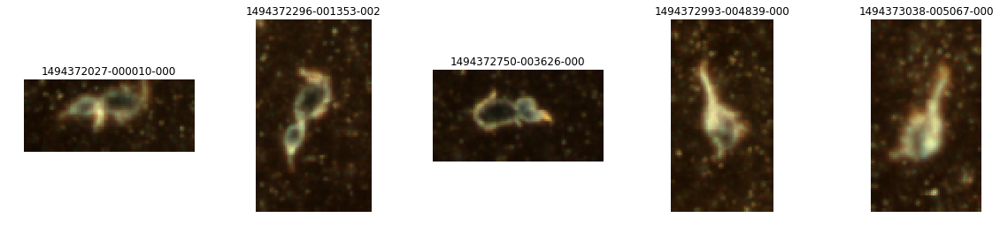


111/132: 20170516_001 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


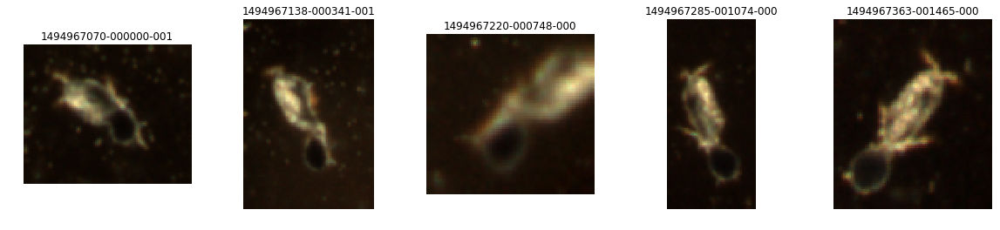


112/132: 20170516_002 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


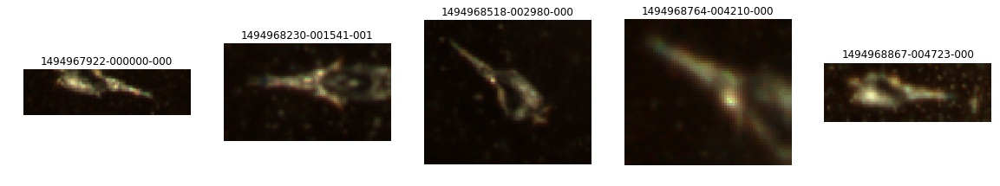


113/132: 20170516_003 Calanoida Calanoida (order) Calanoida (order)


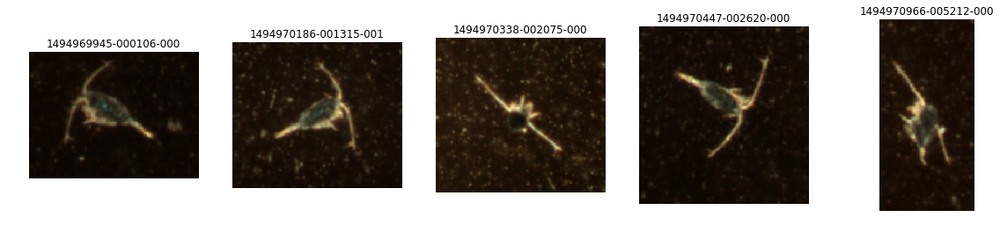


114/132: 20170516_004 Calanoida Calanidae Calanus


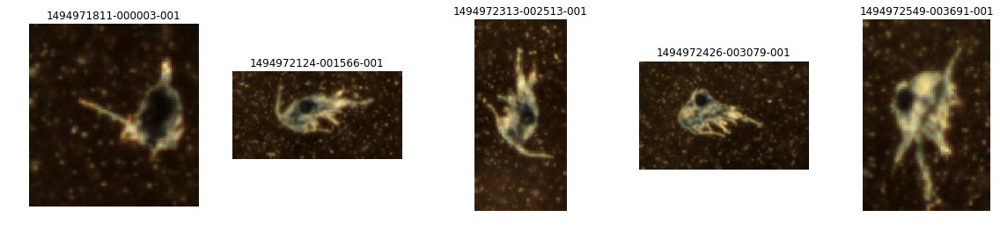


115/132: 20170516_005 Unknown Unknown Unknown


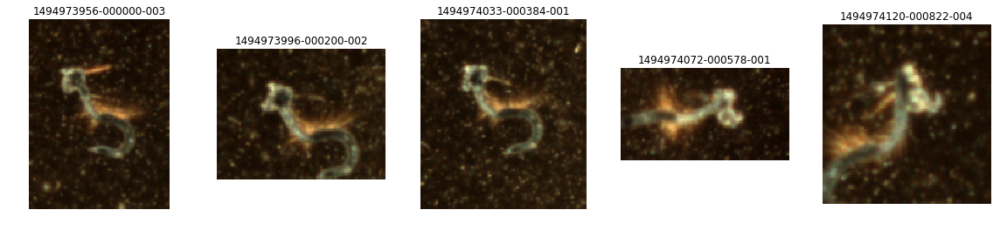


116/132: 20170516_006 Amphipoda Gammaridae Gammaridae (family)


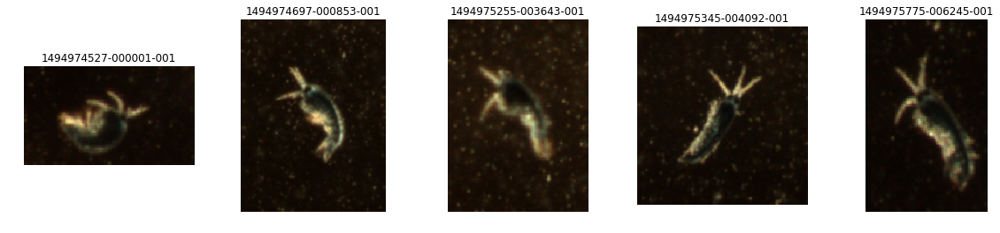


117/132: 20170516_007 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


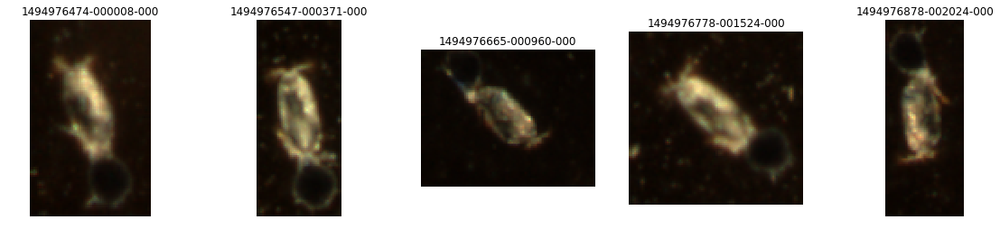


118/132: 20170516_008 Calanoida Acartiidae Acartiidae (family)


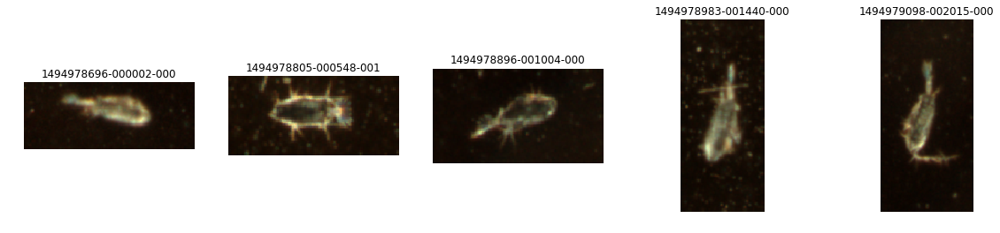


119/132: 20170518_001 Amphipoda Gammaridae Gammaridae (family)


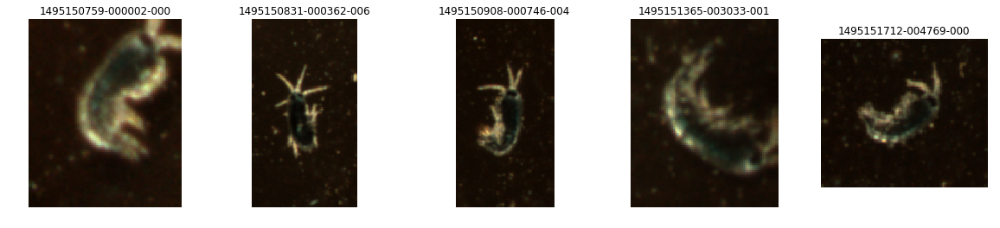


120/132: 20170601_001 Unknown Unknown Unknown


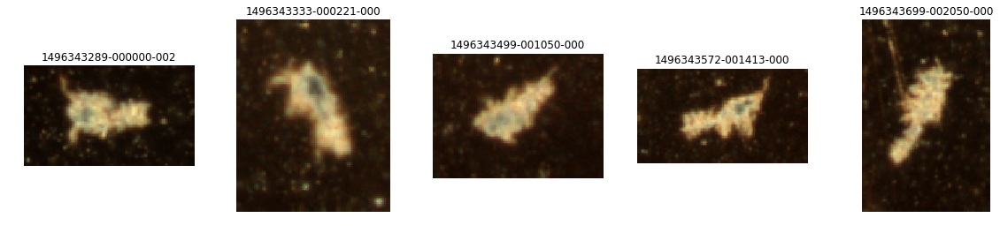


121/132: 20170601_002 Unknown Unknown Unknown


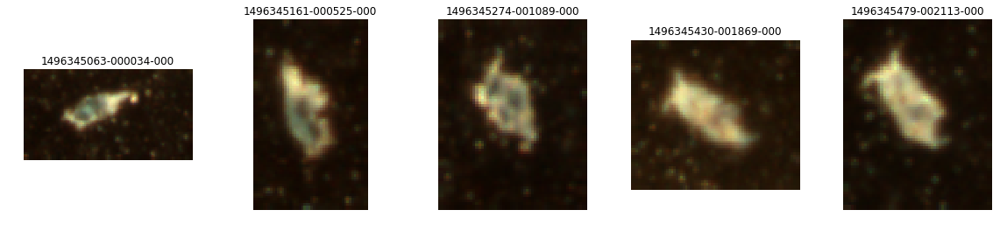


122/132: 20170601_003 Calanoida Calanoida (order) Calanoida (order)


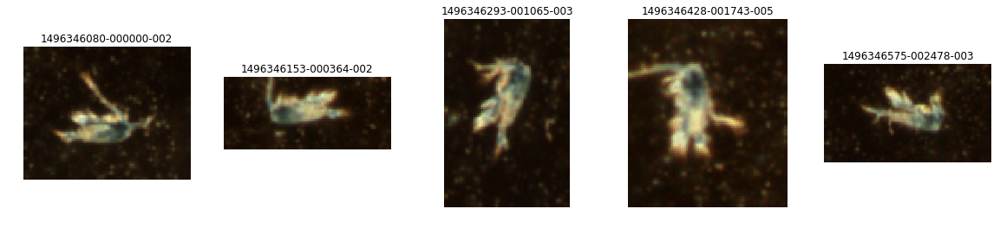


123/132: 20171128_001 Unknown Unknown Unknown


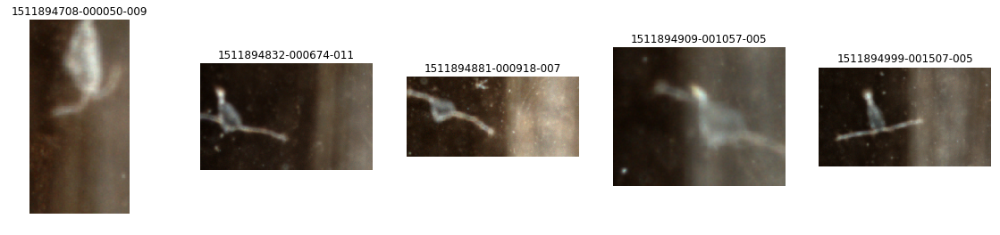


124/132: 20171130_001 Unknown Unknown Unknown


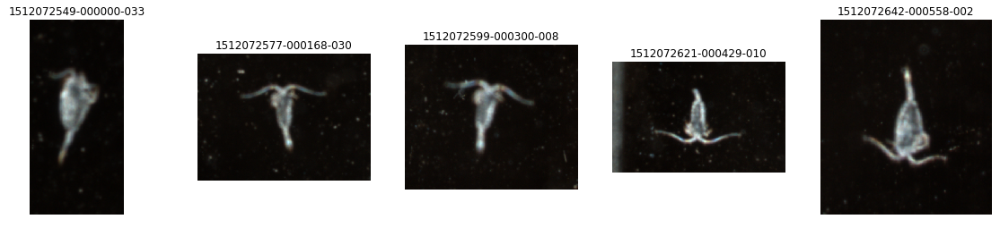


125/132: 20171130_004 Unknown Unknown Unknown


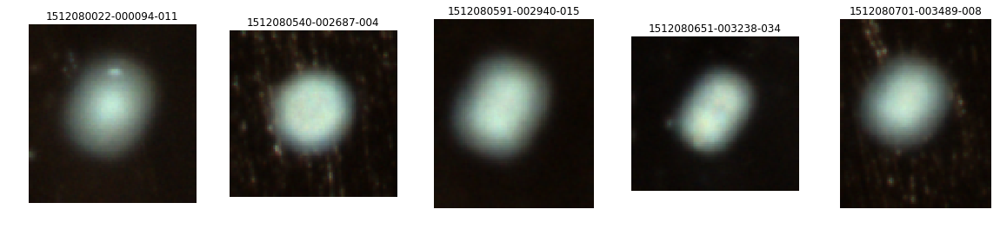


126/132: 20171205_001 Unknown Unknown Unknown


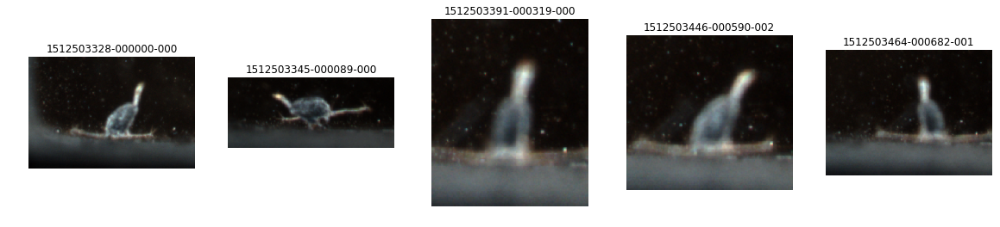


127/132: 20171207_001 Unknown Unknown Unknown


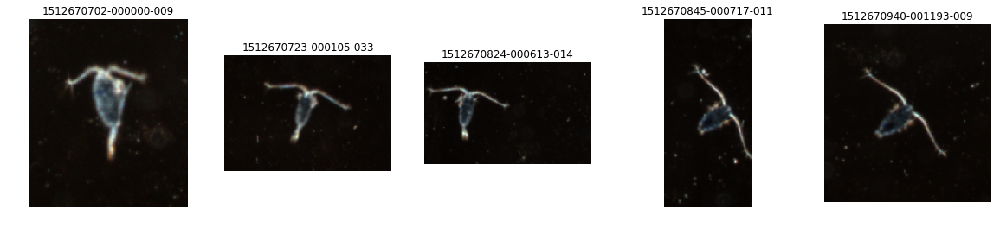


128/132: 20171207_002 Unknown Unknown Unknown


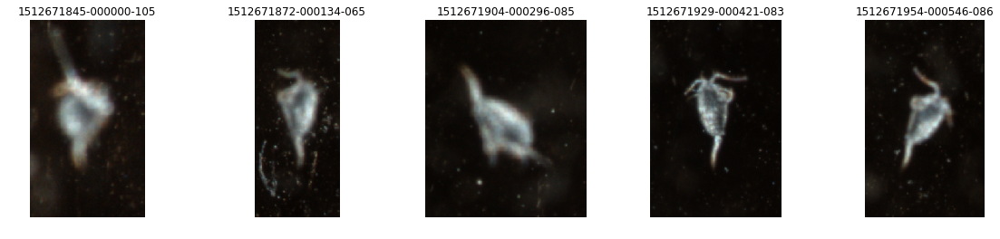


129/132: 20171207_003 Unknown Unknown Unknown


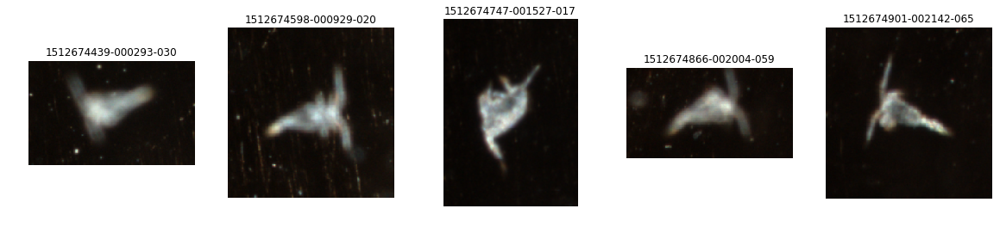


130/132: 20171207_004 Unknown Unknown Unknown


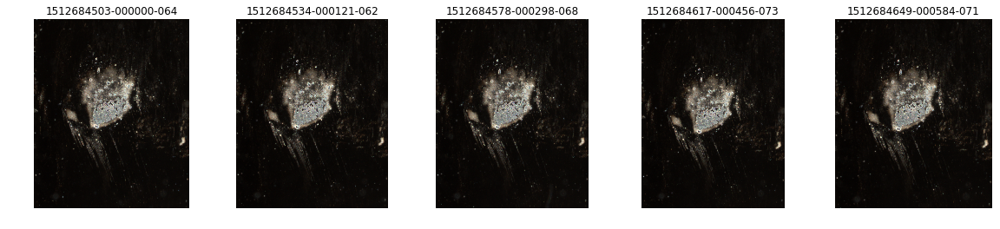


131/132: 20171207_005 Unknown Unknown Unknown


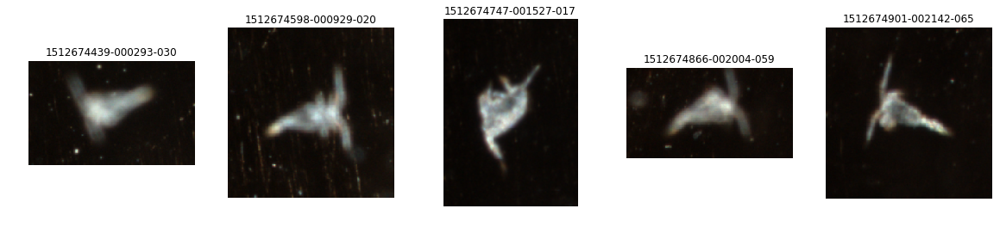


132/132: 20171207_006 Unknown Unknown Unknown


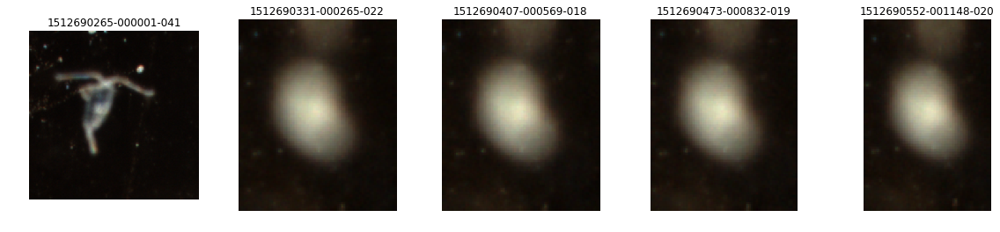

In [44]:
specimen_list = sorted(os.listdir('rawcolor_db2/images'))
for i, spc in enumerate(specimen_list):
    images_fn = open('rawcolor_db/subsets/{}-timeseries.lst'.format(spc)).read().splitlines()
    meta = json.load(open('rawcolor_db/meta/{}-meta.json'.format(spc)))
    meta = meta[images_fn[0]]
    
    print '\n{:03d}/{:03d}: {} {} {} {}'.format(i+1, len(specimen_list), spc, meta['order'], meta['family'], meta['genus'])
    f, axarray = plt.subplots(1, 5, figsize=(20, 4))
    for j in range(5):
        fn = images_fn[int(j/5.*len(images_fn))]
        img = plt.imread(os.path.join('rawcolor_db', 'images', fn))
        axarray[j].imshow(img)
        axarray[j].set_axis_off()
        axarray[j].set_title(fn.split('/')[-1][9:30])
    plt.show()


### Visualize Pose


001/132: 20170124_001 Amphipoda Gammaridae Gammaridae (family)


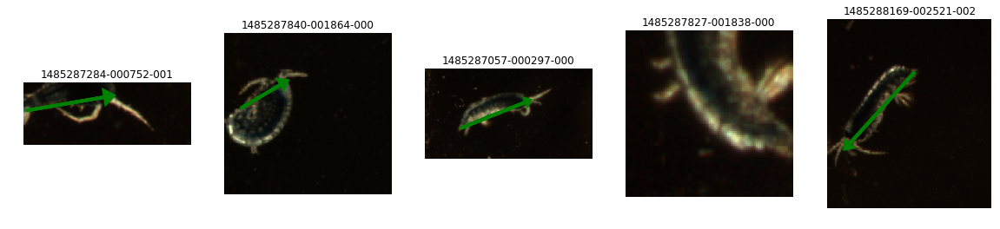


002/132: 20170124_002 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


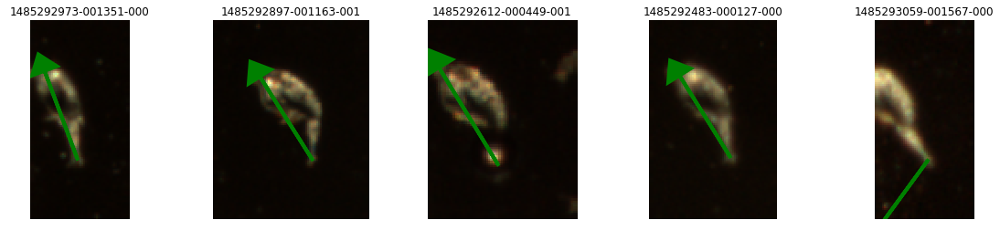


003/132: 20170126_001 Appendicularia (class) Appendicularia (class) Appendicularia (class)


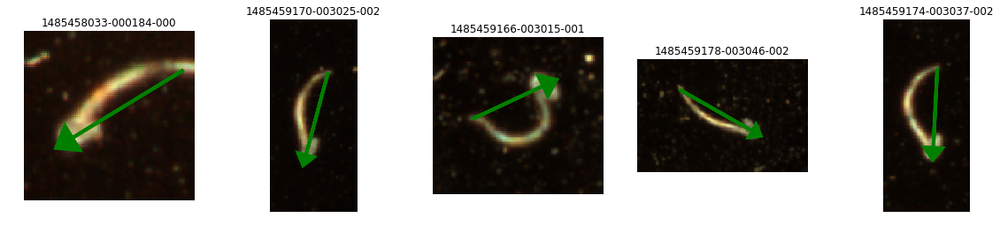


004/132: 20170126_002 Mysida Mysida (order) Mysida (order)


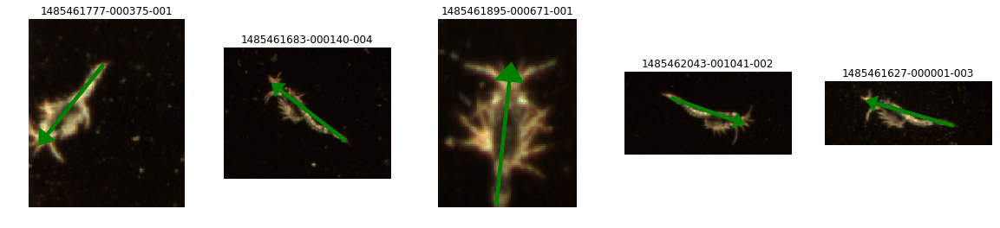


005/132: 20170126_003 Calanoida Calanoida (order) Calanoida (order)


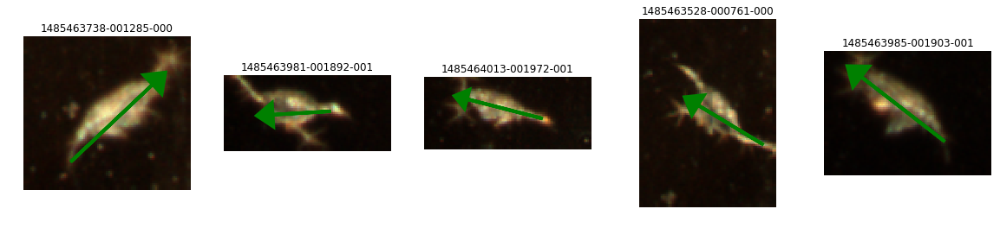


006/132: 20170130_001 Calanoida Calanidae Calanus


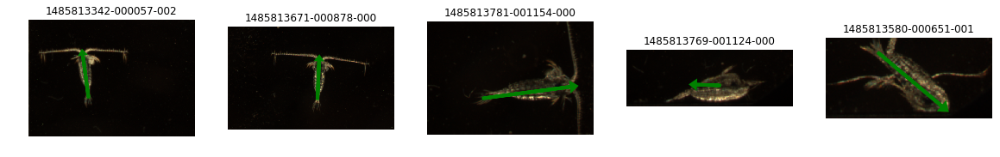


007/132: 20170130_002 Mysida Mysida (order) Mysida (order)


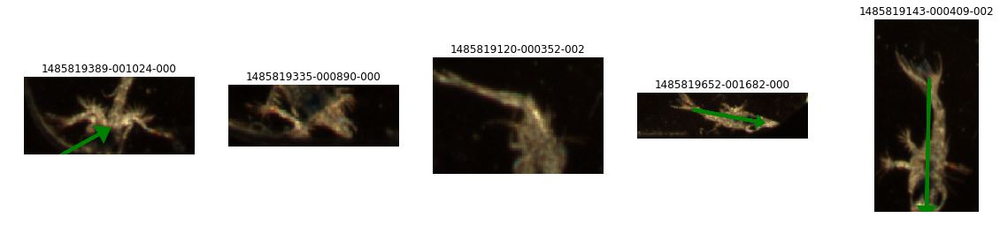


008/132: 20170130_003 Decapoda Brachyura Brachyura (family)


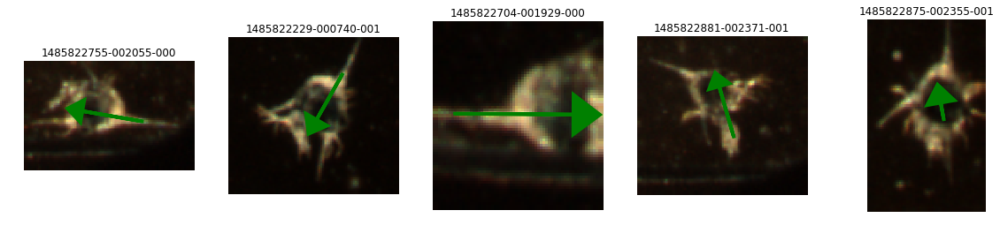


010/132: 20170131_002 Mysida Mysida (order) Mysida (order)


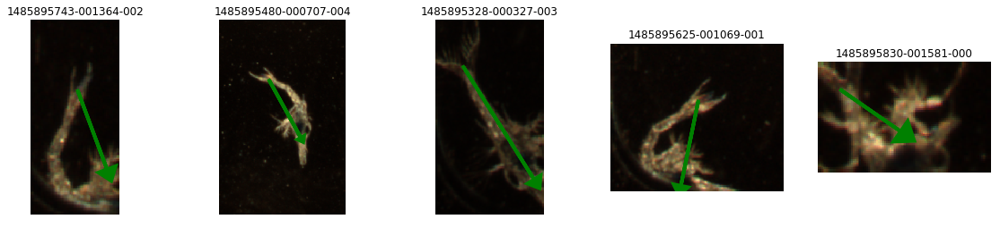


011/132: 20170203_001 Calanoida Calanoida (order) Calanoida (order)


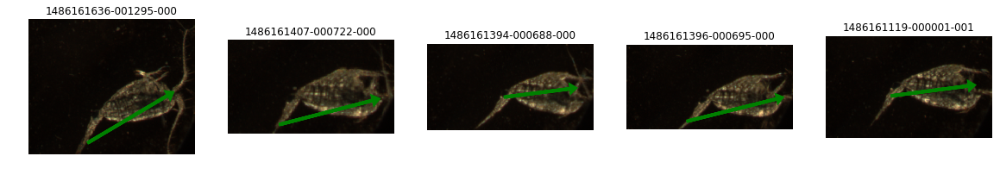


012/132: 20170203_002 Ostracoda (class) Ostracoda (class) Ostracoda (class)


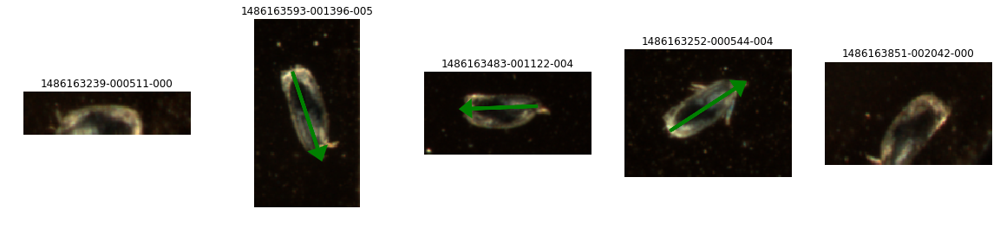


014/132: 20170206_002 Euphausiacea Euphausiidae Euphausiidae (family)


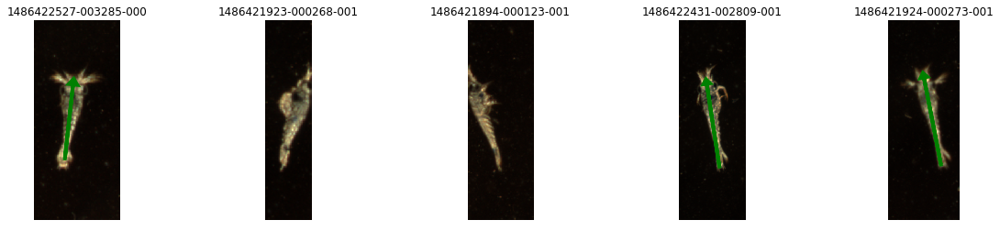


015/132: 20170207_001 Calanoida Calanoida (order) Calanoida (order)


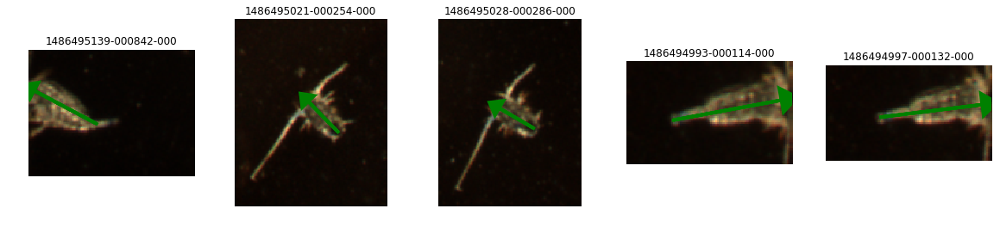


016/132: 20170207_003 Cydippida Cydippida (order) Cydippida (order)


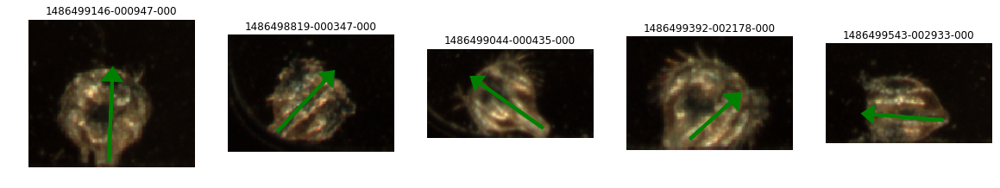


017/132: 20170207_004 Siphonophorae Diphyidae Diphyidae (family)


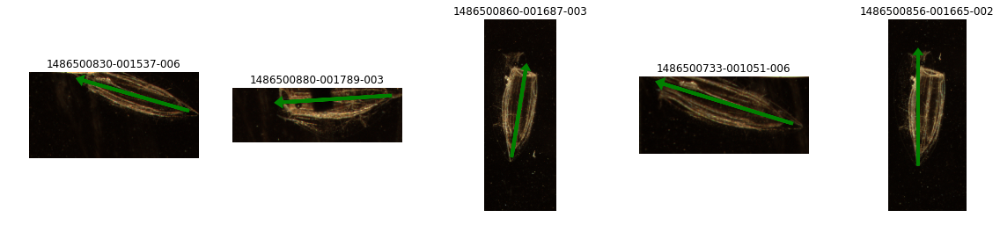


018/132: 20170207_006 Euphausiacea Euphausiidae Euphausiidae (family)


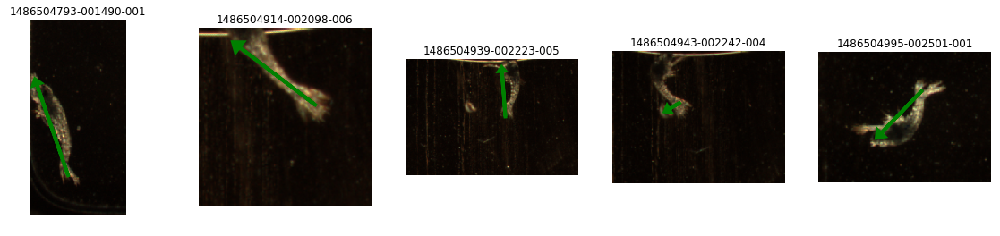


019/132: 20170209_001 Calanoida Calanoida (order) Calanoida (order)


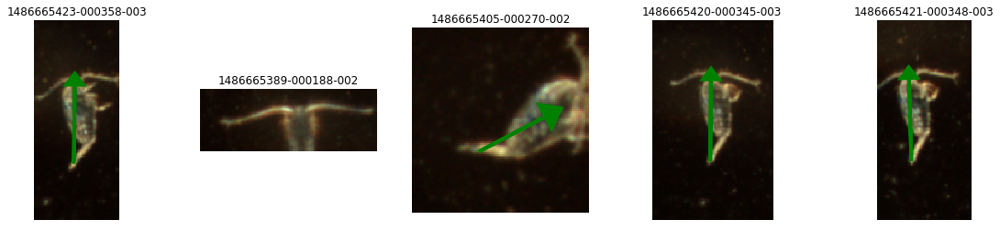


020/132: 20170209_002 Calanoida Pontellidae Pontellidae (family)


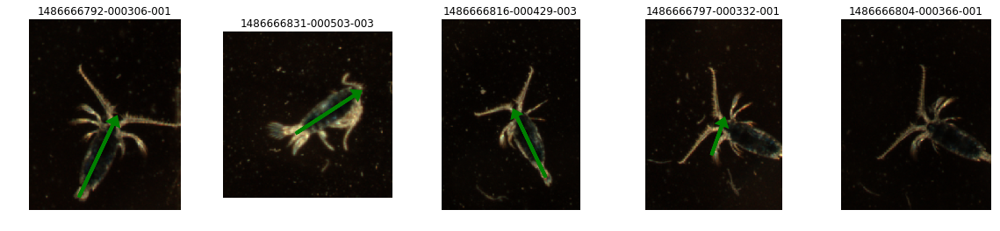


021/132: 20170209_003 Ostracoda (class) Ostracoda (class) Ostracoda (class)


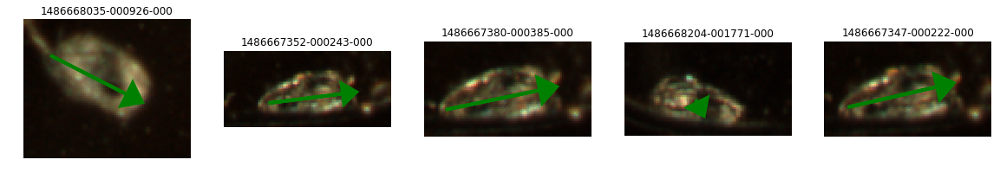


022/132: 20170210_001 Cydippida Cydippida (order) Cydippida (order)


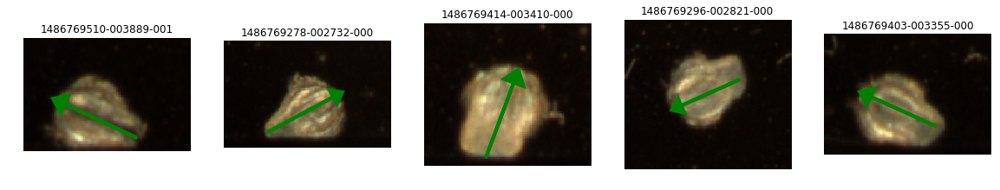


024/132: 20170213_001 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


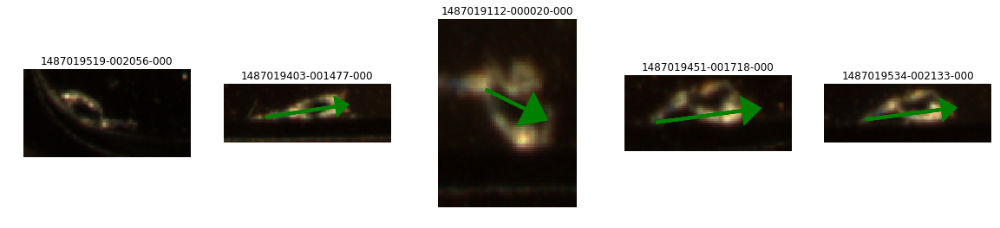


026/132: 20170213_003 Calanoida Calanoida (order) Calanoida (order)


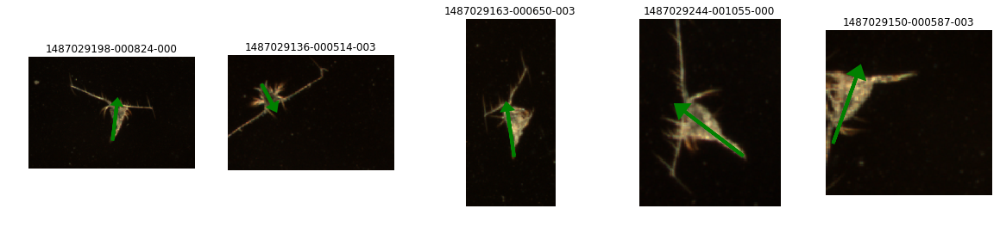


028/132: 20170214_002 Calanoida Calanoida (order) Calanoida (order)


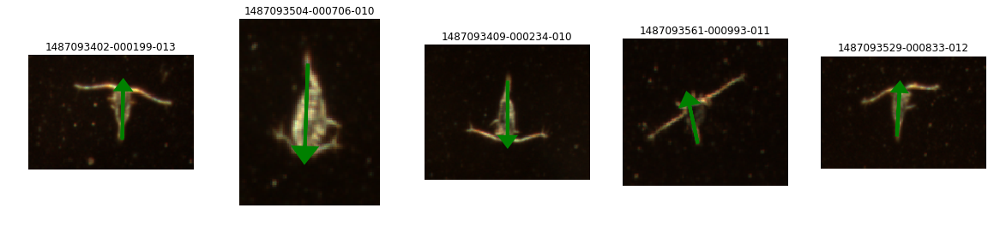


029/132: 20170214_003 Calanoida Calanoida (order) Calanoida (order)


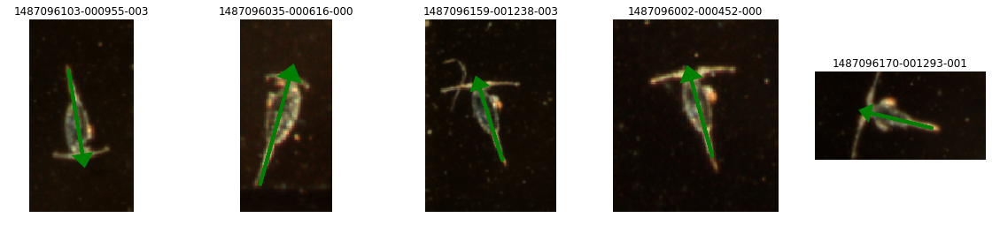


030/132: 20170214_004 Amphipoda Gammaridae Gammaridae (family)


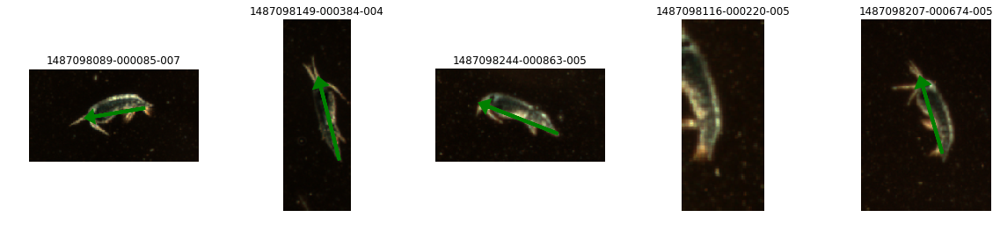


031/132: 20170214_005 Calanoida Calanoida (order) Calanoida (order)


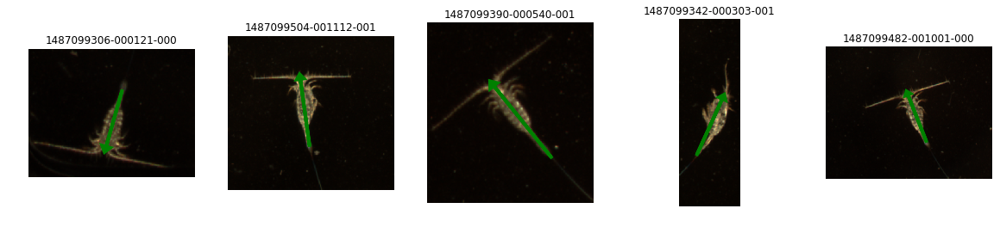


033/132: 20170216_001 Cyclopoida Oithonidae Oithonidae (family)


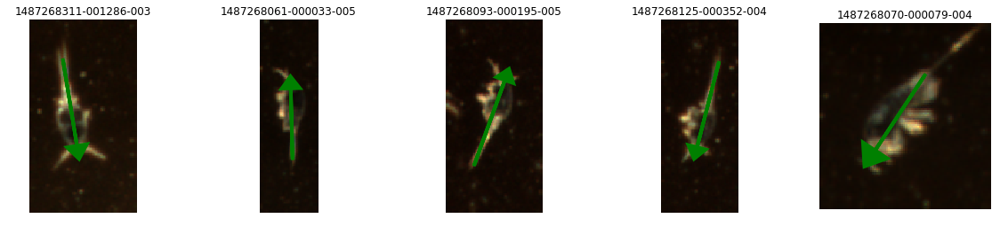


034/132: 20170216_002 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


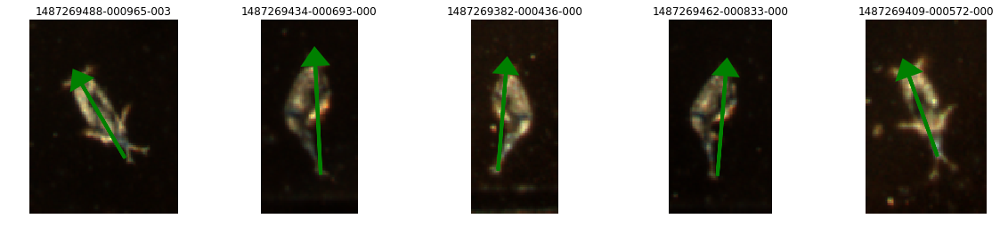


036/132: 20170216_004 Cyclopoida Oithonidae Oithonidae (family)


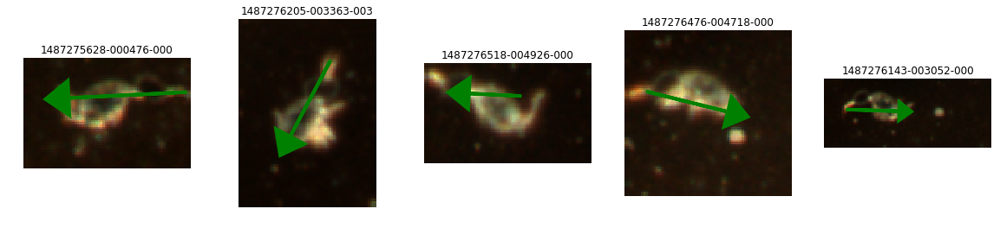


037/132: 20170216_005 Calanoida Calanoida (order) Calanoida (order)


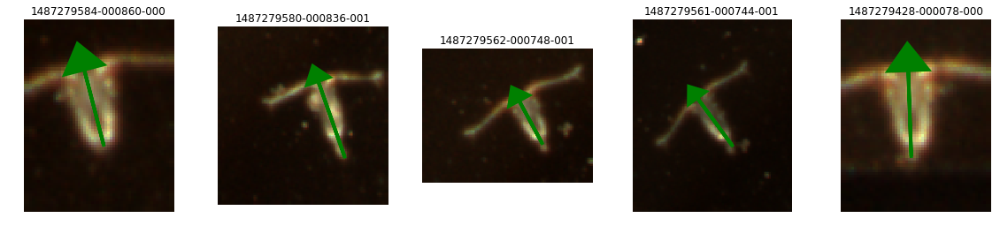


039/132: 20170217_001 Calanoida Acartiidae Acartiidae (family)


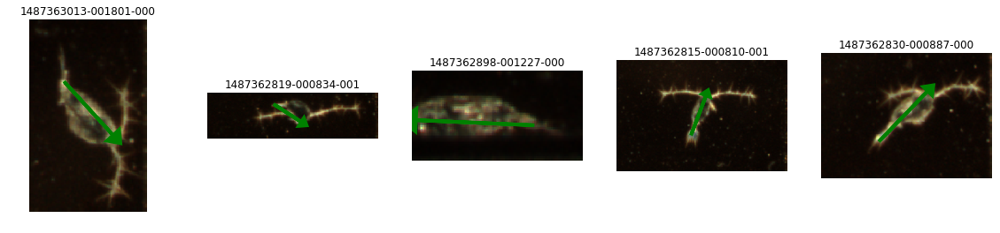


040/132: 20170217_002 Calanoida Acartiidae Acartiidae (family)


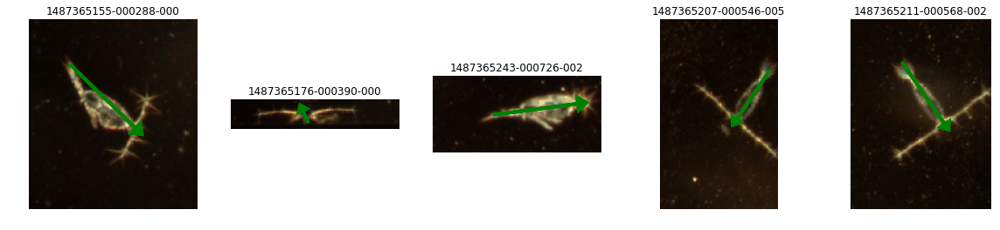


041/132: 20170217_003 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


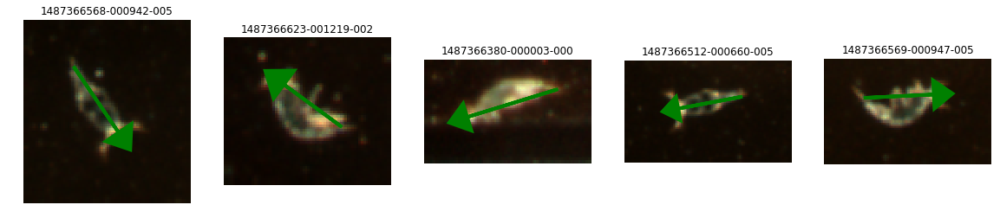


042/132: 20170217_004 Calanoida Calanoida (order) Calanoida (order)


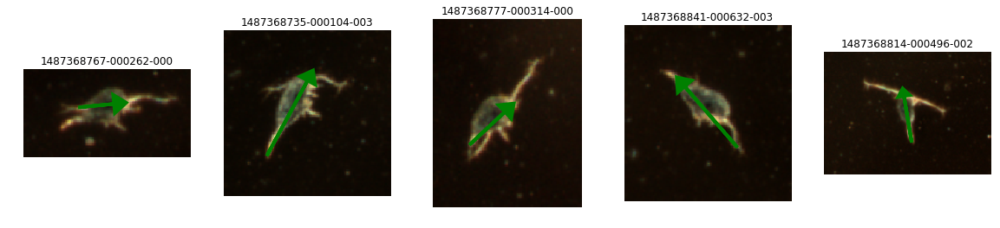


044/132: 20170217_006 Cyclopoida Oithonidae Oithonidae (family)


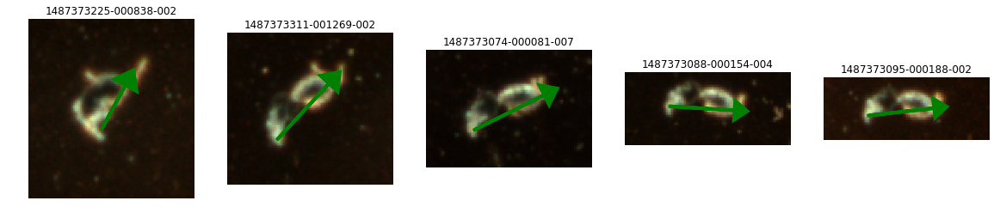


046/132: 20170221_001 Decapoda Brachyura Brachyura (family)


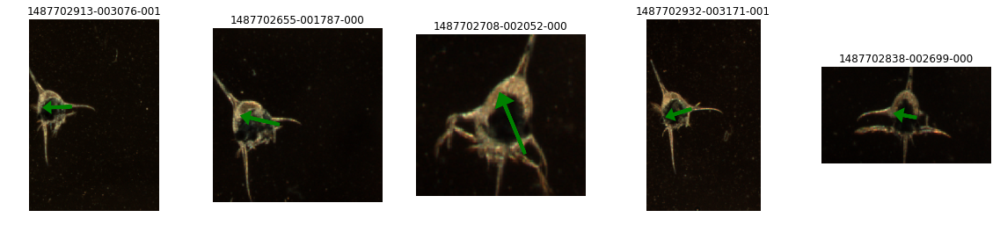


047/132: 20170221_002 Euphausiacea Euphausiidae Euphausiidae (family)


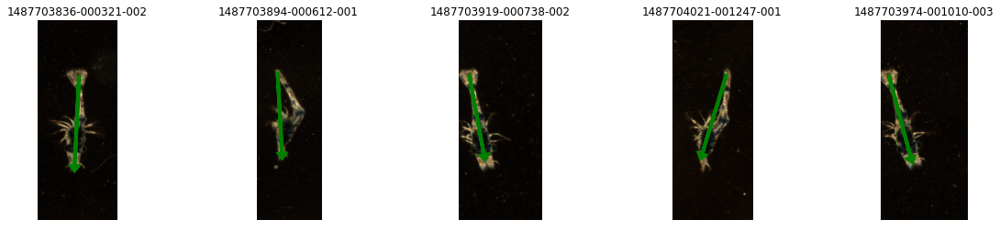


048/132: 20170221_003 Decapoda Brachyura Brachyura (family)


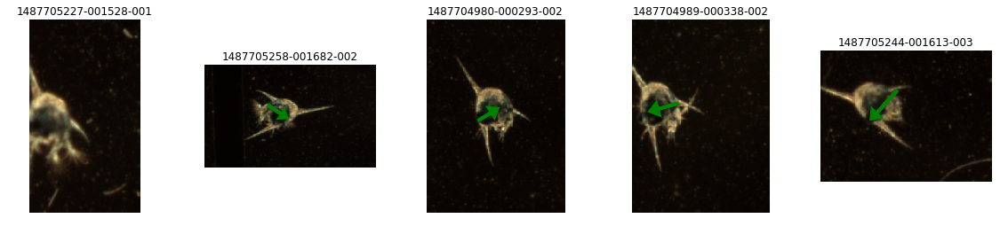


049/132: 20170221_004 Decapoda Brachyura Brachyura (family)


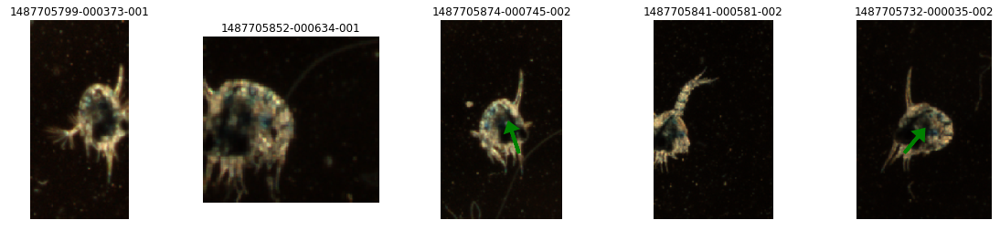


050/132: 20170221_005 Decapoda Brachyura Brachyura (family)


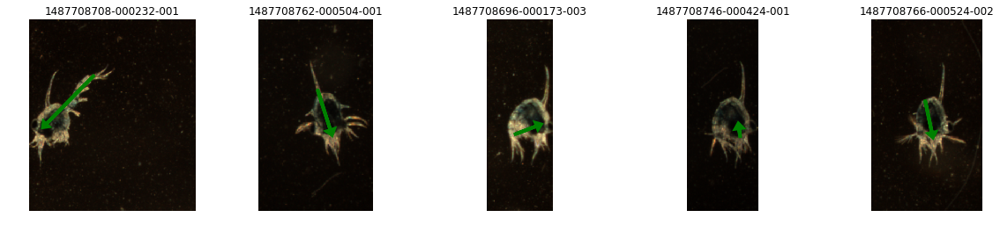


053/132: 20170223_001 Calanoida Calanoida (order) Calanoida (order)


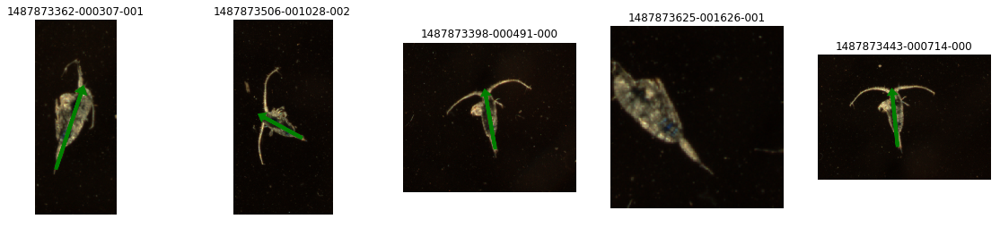


054/132: 20170223_002 Calanoida Tortanidae Tortanus


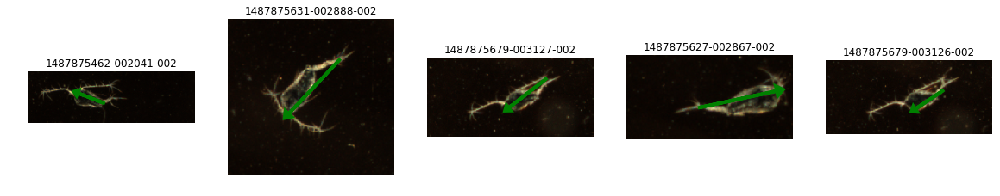


058/132: 20170224_004 Cyclopoida Oithonidae Oithonidae (family)


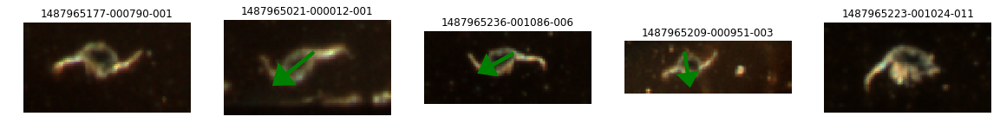


059/132: 20170224_005 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


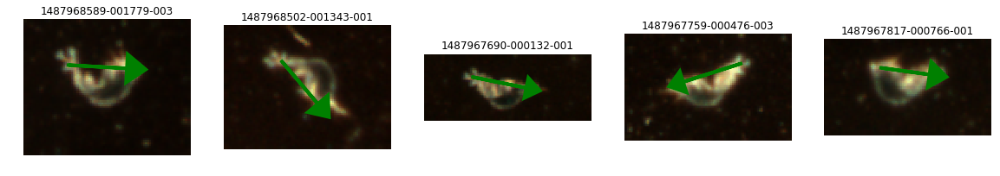


064/132: 20170224_010 Calanoida Calanoida (order) Calanoida (order)


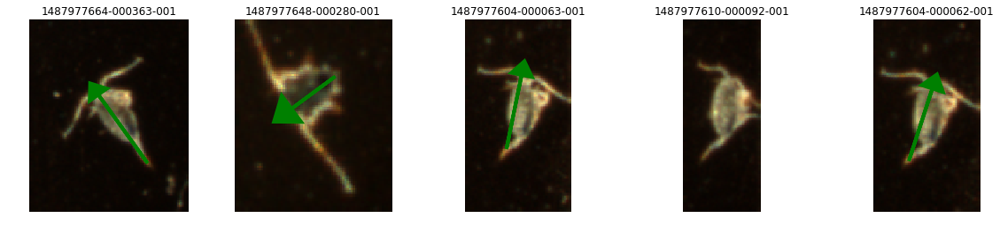


070/132: 20170302_001 Calanoida Acartiidae Acartiidae (family)


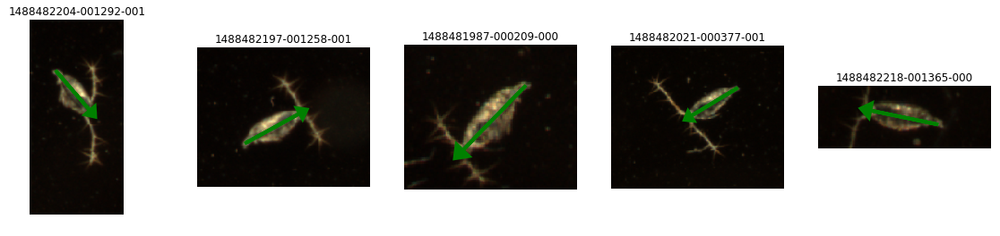


075/132: 20170303_004 Calanoida Calanoida (order) Calanoida (order)


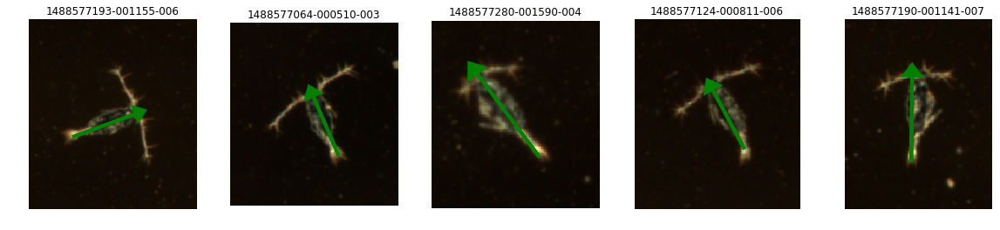


076/132: 20170303_005 Calanoida Calanoida (order) Calanoida (order)


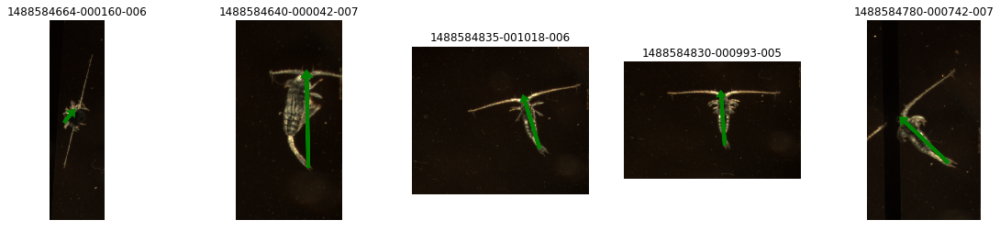


077/132: 20170306_001 Amphipoda Gammaridae Gammaridae (family)


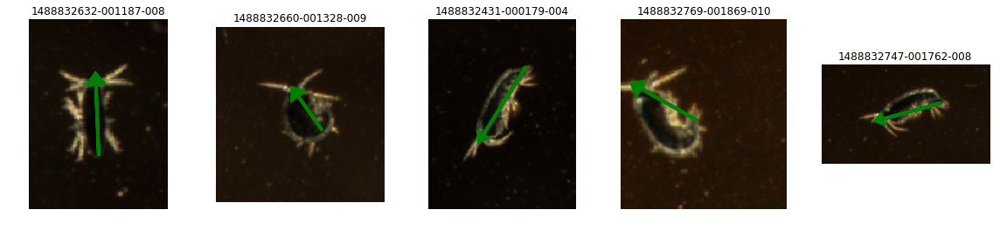


078/132: 20170306_002 Amphipoda Gammaridae Gammaridae (family)


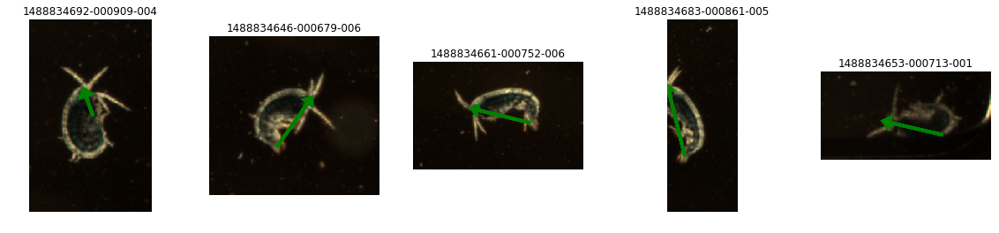


080/132: 20170306_004 Calanoida Calanoida (order) Calanoida (order)


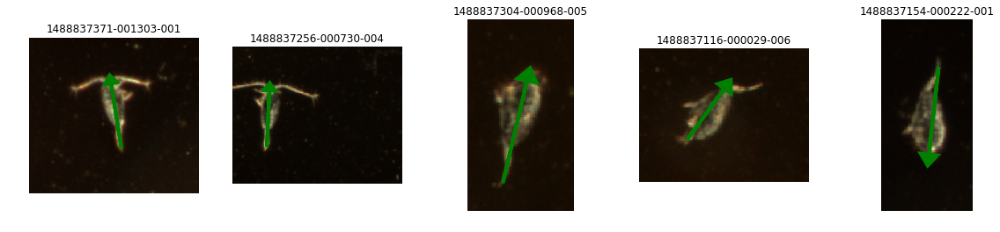


081/132: 20170306_005 Calanoida Calanoida (order) Calanoida (order)


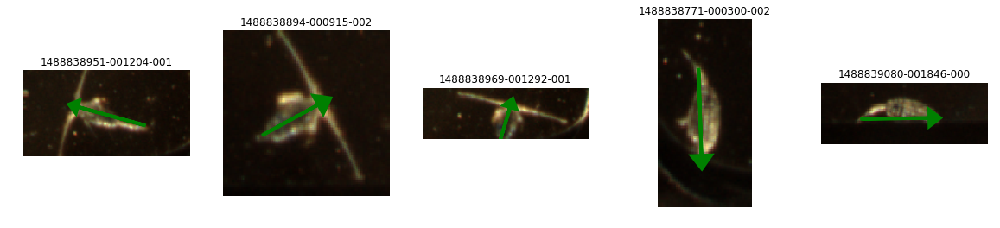


082/132: 20170306_006 Calanoida Calanoida (order) Calanoida (order)


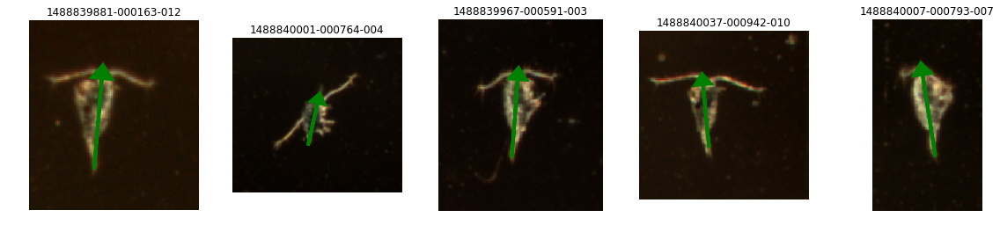


083/132: 20170306_007 Amphipoda Gammaridae Gammaridae (family)


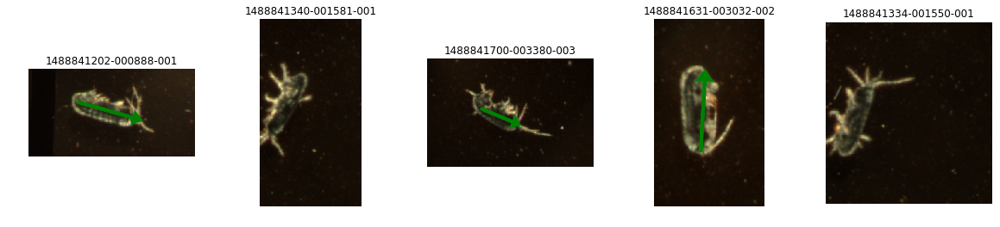


084/132: 20170307_001 Amphipoda Gammaridae Gammaridae (family)


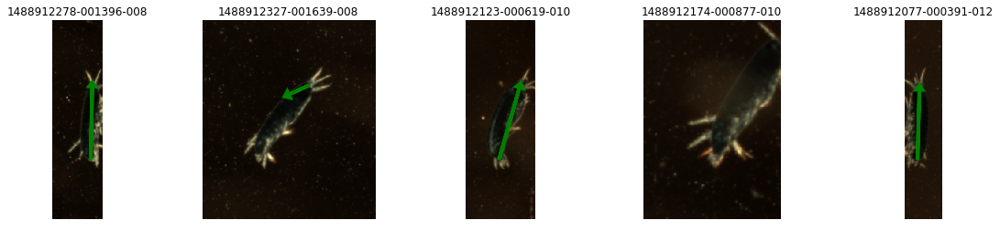


085/132: 20170307_002 Calanoida Calanoida (order) Calanoida (order)


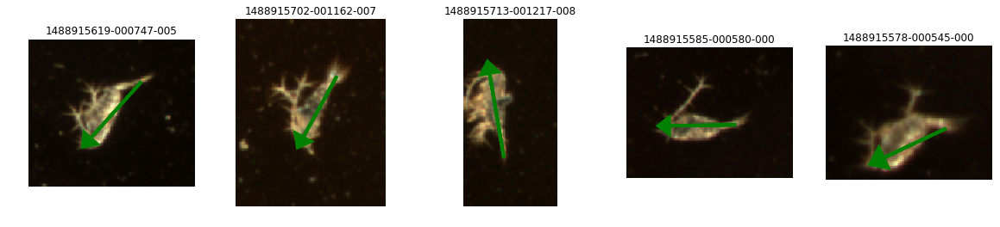


086/132: 20170307_003 Amphipoda Gammaridae Gammaridae (family)


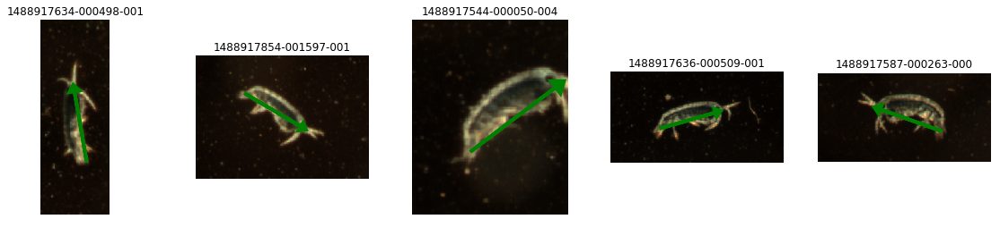


087/132: 20170420_001 Appendicularia (class) Appendicularia (class) Appendicularia (class)


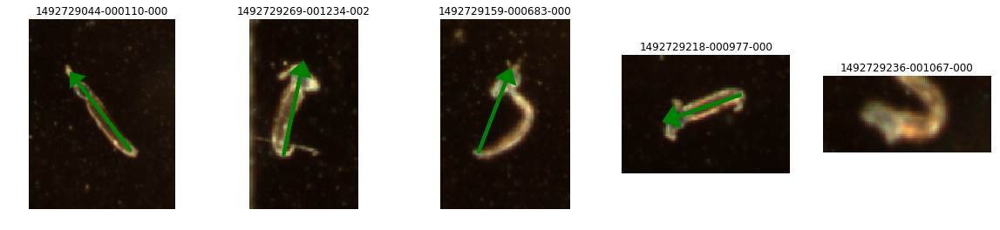


089/132: 20170425_002 Calanoida Acartiidae Acartiidae (family)


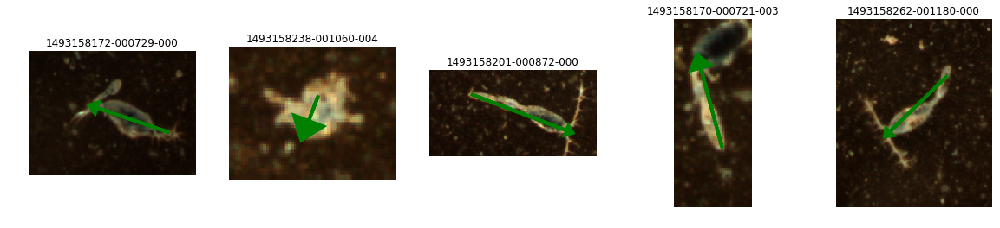


091/132: 20170425_004 Calanoida Calanoida (order) Calanoida (order)


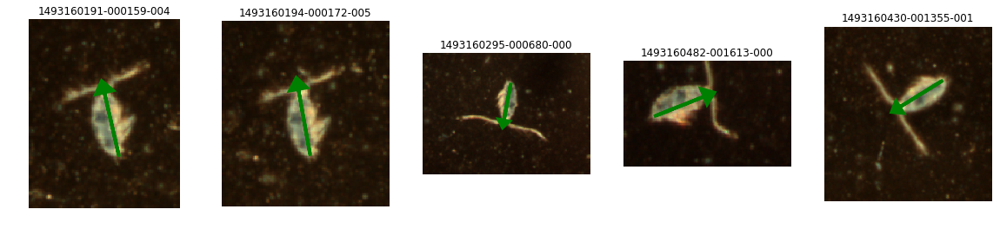


092/132: 20170425_005 Calanoida Calanoida (order) Calanoida (order)


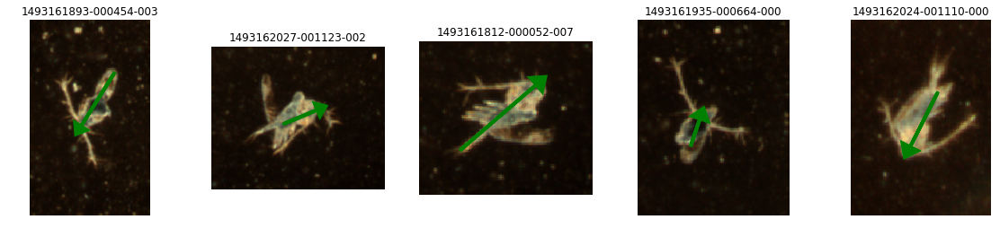


094/132: 20170427_002 Calanoida Calanoida (order) Calanoida (order)


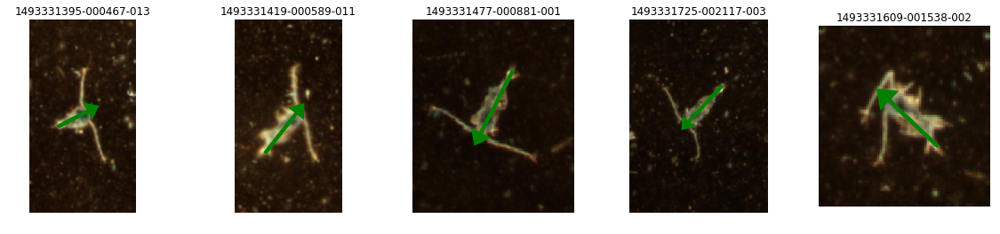


095/132: 20170427_003 Amphipoda Gammaridae Gammaridae (family)


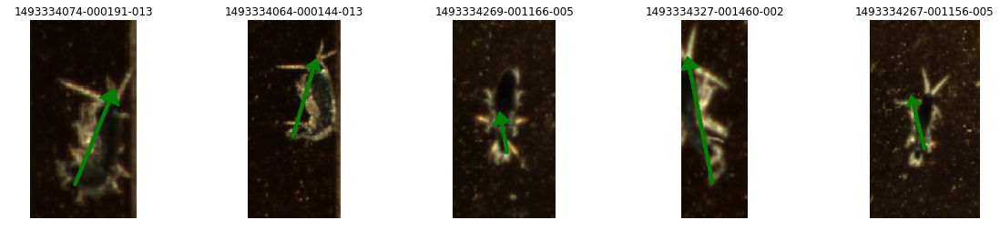


096/132: 20170427_004 Calanoida Calanoida (order) Calanoida (order)


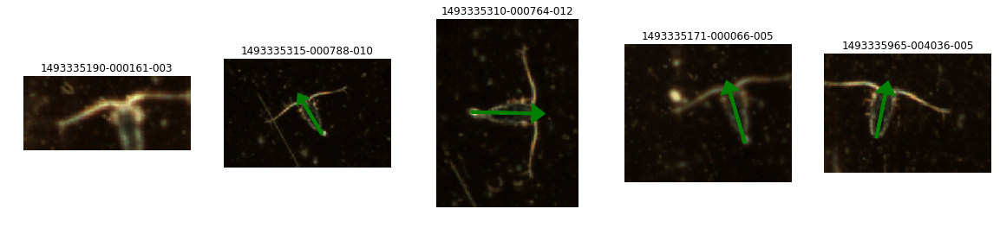


098/132: 20170502_002 Amphipoda Gammaridae Gammaridae (family)


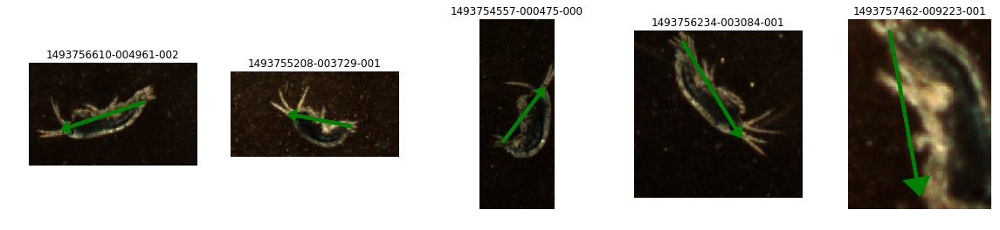


100/132: 20170504_002 Calanoida Calanoida (order) Calanoida (order)


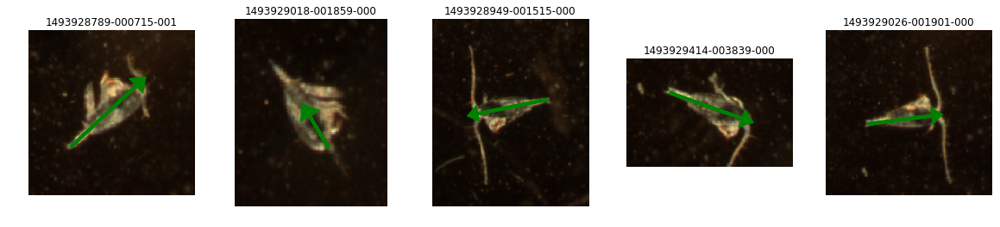


101/132: 20170504_003 Calanoida Calanoida (order) Calanoida (order)


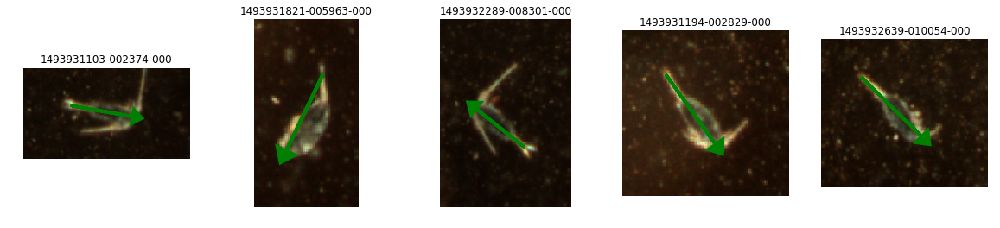


104/132: 20170504_006 Euphausiacea Euphausiidae Euphausiidae (family)


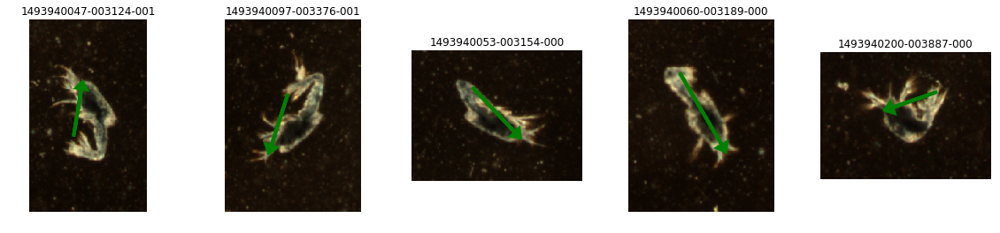


105/132: 20170504_007 Calanoida Calanoida (order) Calanoida (order)


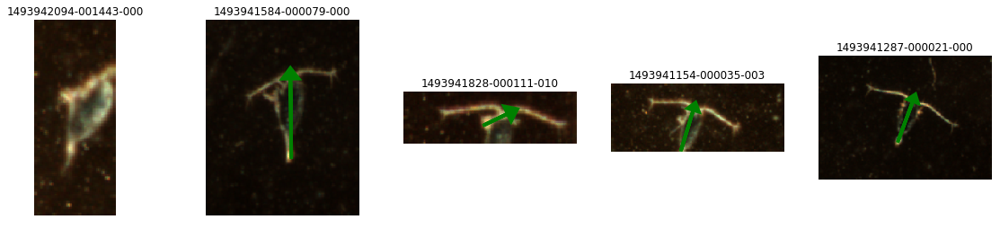


106/132: 20170509_001 Calanoida Calanoida (order) Calanoida (order)


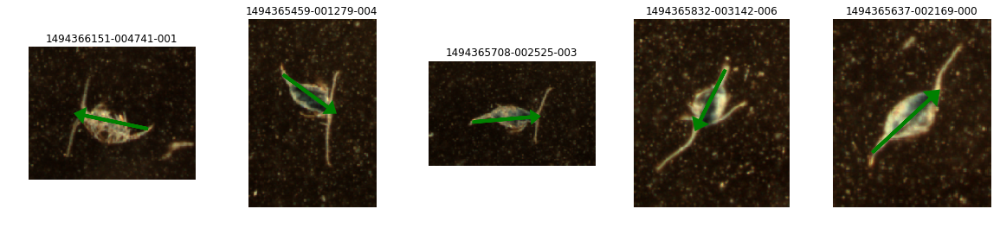


109/132: 20170509_004 Cyclopoida Oithonidae Oithonidae (family)


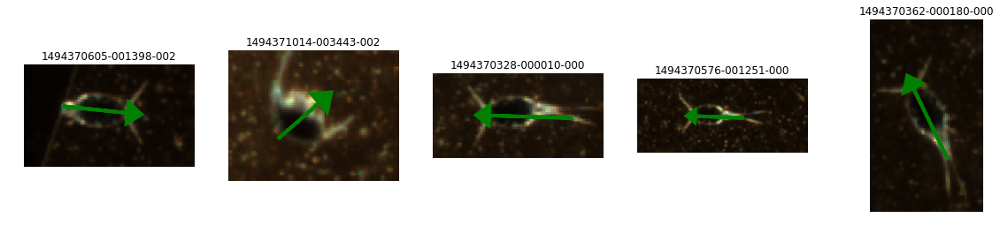


111/132: 20170516_001 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


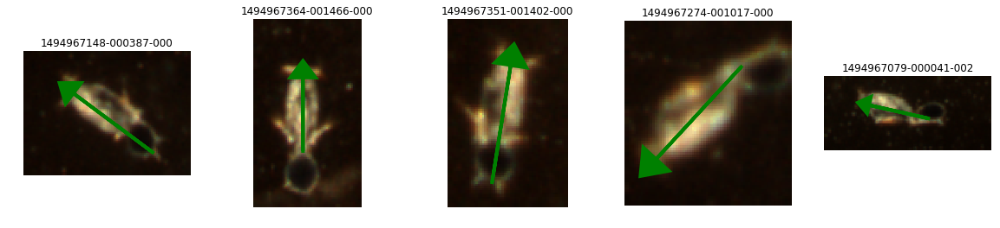


112/132: 20170516_002 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


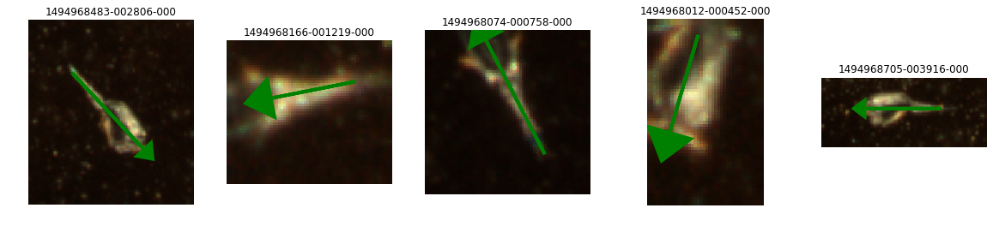


113/132: 20170516_003 Calanoida Calanoida (order) Calanoida (order)


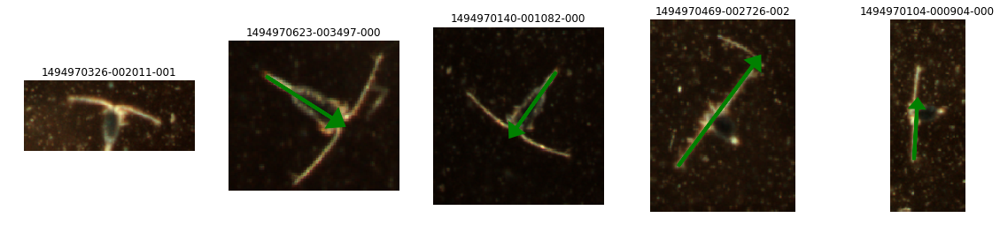


116/132: 20170516_006 Amphipoda Gammaridae Gammaridae (family)


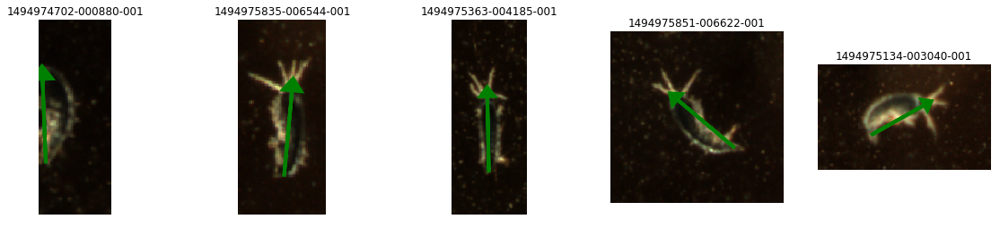


117/132: 20170516_007 Cyclopoida Poecilostomatoida Poecilostomatoida (family)


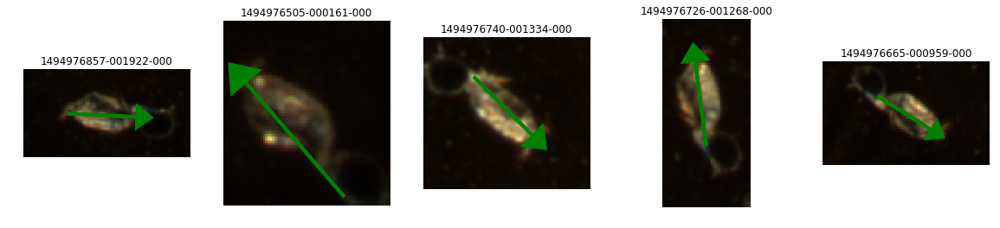


118/132: 20170516_008 Calanoida Acartiidae Acartiidae (family)


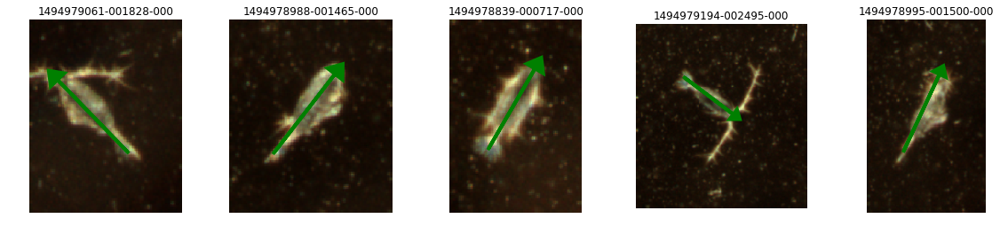


119/132: 20170518_001 Amphipoda Gammaridae Gammaridae (family)


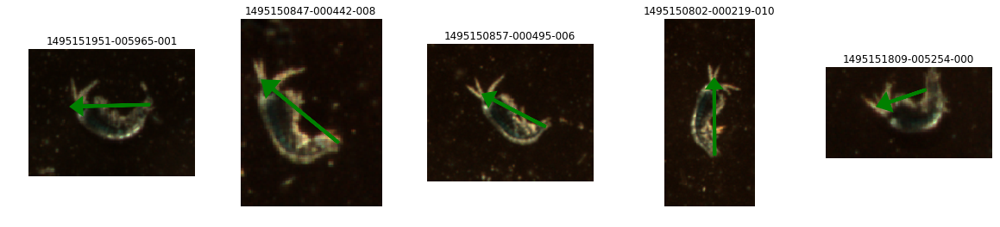


122/132: 20170601_003 Calanoida Calanoida (order) Calanoida (order)


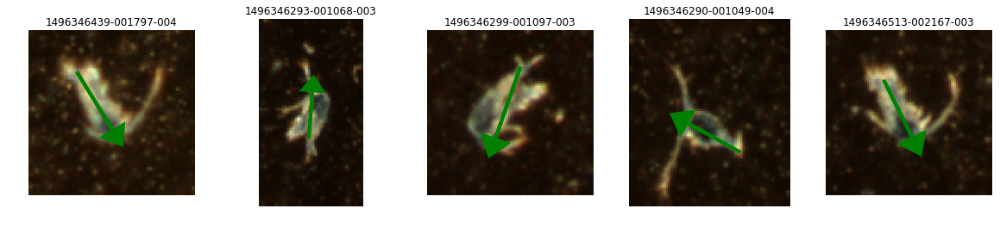

In [2]:
specimen_list = sorted(os.listdir('rawcolor_db/images'))
for i, spc in enumerate(specimen_list):
    meta = json.load(open('rawcolor_db/meta/{}-meta.json'.format(spc)))
    images_fn = [fn for fn in meta if 'annotation' in meta[fn]]
    if len(images_fn) == 0:
        continue
        
    order, family, genus = meta[images_fn[0]]['order'], meta[images_fn[0]]['family'], meta[images_fn[0]]['genus']
    print '\n{:03d}/{:03d}: {} {} {} {}'.format(i+1, len(specimen_list), spc, order, family, genus)
    
    f, axarray = plt.subplots(1, 5, figsize=(20, 4))
    for j in range(5):
        fn = images_fn[int(j/5.*len(images_fn))]
        img = plt.imread(os.path.join('rawcolor_db', 'images', fn))
        axarray[j].imshow(img)
        axarray[j].set_axis_off()
        axarray[j].set_title(fn.split('/')[-1][9:30])
        
        pose = meta[fn]['annotation']
        head_oof = [isinstance(p['head'], dict) for p in pose]
        tail_oof = [isinstance(p['tail'], dict) for p in pose]
        if not all(tail_oof) or not all(head_oof):
            continue
        
        head_x = np.median([p['head']['x'] for p in pose])
        head_y = np.median([p['head']['y'] for p in pose])
        tail_x = np.median([p['tail']['x'] for p in pose])
        tail_y = np.median([p['tail']['y'] for p in pose])
        
        axarray[j].arrow(tail_x, tail_y, head_x-tail_x, head_y-tail_y, 
                 head_width=15, head_length=10, fc='g', ec='g', lw=4)

    plt.show()


### Visualize Meta

In [49]:
specimen_list = sorted(os.listdir('rawcolor_db/images'))  # All specimens
for i, spc in enumerate(specimen_list):
    meta = json.load(open('rawcolor_db/meta/{}-meta.json'.format(spc)))
    
    # Load specimen dataset
    # *-timeseries.lst contains all images of a specific specimen in order
    # *-train.lst contains the first 50% of the timeseries images
    # *-valid.lst contains the subset from 60-70% of the timeseries images
    # *-test.lst contains the subset from 80-100% of the timeseries images
    # In all these files, images appear in order. These should be shuffled during training.
    all_images_fn = open('rawcolor_db/subsets/{}-timeseries.lst'.format(spc)).read().splitlines()
    train_images_fn = open('rawcolor_db/subsets/{}-train.lst'.format(spc)).read().splitlines()
    valid_images_fn = open('rawcolor_db/subsets/{}-valid.lst'.format(spc)).read().splitlines()
    test_images_fn = open('rawcolor_db/subsets/{}-test.lst'.format(spc)).read().splitlines()
    
    # Find one image with pose annotation
    example_img = [fn for fn in all_images_fn if 'annotation' in meta[fn]]
    if len(example_img) == 0:
        continue
    else:
        example_img = example_img[0]
        
    # Get labels for example image. The labels are the same for all images of the same specimen
    order, family, genus = meta[example_img]['order'], meta[example_img]['family'], meta[example_img]['genus']
    
    # The metadata file is a large dictionary with filenames as keys.
    # Metadata for each file is then stored in a dictionary with the following fileds:
    #    'area', 'aspect_ratio', 'filename', 'width', 'height', 'major_axis_length', 'minor_axis_length', 'timestamp'
    #    'timestring', 'order', 'family', 'genus' and 'annotation'
    # The 'order', 'family' and 'genus' fields contain the taxonomix labels of the image.
    # The 'annotation' field contain turk pose annotation, and is organized as a list of dictionaries,
    #    where each entry represents one turk annotation, containing the following fields:
    #    'worker_id', 'focus', 'z-dir', 'head' and 'tail'.
    # If no 'annotation' field is present, then no turk annotations have been collected yet for the image.
    print '\n', '='*30, '{:03d}/{:03d}'.format(i+1, len(specimen_list)),'='*30
    print 'Specimen ID:   ', spc
    print 'Total images:  ', len(all_images_fn)
    print 'Train images:  ', len(train_images_fn)
    print 'Valid images:  ', len(valid_images_fn)
    print 'Test images:   ', len(test_images_fn)
    
    # Print example image and its taxonomic labels
    print '\nExample image: ', example_img
    print 'Order:         ', order
    print 'Family:        ', family
    print 'Genus:         ', genus
    
    # Print metadata
    print '\nMeta fields:   '
    for k in sorted(meta[example_img].keys()):
        if k == 'annotation':
            continue
        print '  '+k, ':', meta[example_img][k]
        
    # Print pose annotation
    for j, ann in enumerate(meta[example_img]['annotation']):
        print '\nTurk annotation #{}:'.format(j+1)
        for k in sorted(ann.keys())[1:]:
            print '  '+k, ':', ann[k]


============================== 001/132 ==============================
Specimen ID:    20170124_001
Total images:   1263
Train images:   631
Valid images:   127
Test images:    253

Example image:  20170124_001/SPCBench-1485286968-000119-000-552-2304-99-88-_rawcolor.png
Order:          Amphipoda
Family:         Gammaridae
Genus:          Gammaridae (family)

Meta fields:   
  area : 1032.0
  aspect_ratio : 0.869331363173
  family : Gammaridae
  filename : 20170124_001/SPCBench-1485286968-000119-000-552-2304-99-88-_rawcolor.png
  genus : Gammaridae (family)
  height : 88.0
  major_axis_length : 41.5613518745
  minor_axis_length : 36.1305866804
  order : Amphipoda
  timestamp : 1485288866.65
  timestring : 2017-01-24 121426
  width : 99.0

Turk annotation #1:
  focus : Out of focus
  head : {u'y': 54.45, u'x': 49.995}
  tail : {u'y': 97.515, u'x': 6.435}
  worker_id : A1W06GIYOJMSAK
  z-dir : Leaning toward camera

Turk annotation #2:
  focus : Slightly out of focus
  head : {u'y': 52.96


============================== 010/132 ==============================
Specimen ID:    20170131_002
Total images:   659
Train images:   329
Valid images:   66
Test images:    132

Example image:  20170131_002/SPCBench-1485895198-000002-001-628-1936-87-464-_rawcolor.png
Order:          Mysida
Family:         Mysida (order)
Genus:          Mysida (order)

Meta fields:   
  area : 5538.0
  aspect_ratio : 0.265382097532
  family : Mysida (order)
  filename : 20170131_002/SPCBench-1485895198-000002-001-628-1936-87-464-_rawcolor.png
  genus : Mysida (order)
  height : 464.0
  major_axis_length : 221.65865127
  minor_axis_length : 58.82423781
  order : Mysida
  timestamp : 1485896775.32
  timestring : 2017-01-31 130615
  width : 87.0

Turk annotation #1:
  focus : Slightly out of focus
  head : {u'y': 273.18, u'x': 56.985}
  tail : {u'y': 116.145, u'x': 74.385}
  worker_id : A3R2HHQ128MHRS
  z-dir : Parallel

Turk annotation #2:
  focus : Slightly out of focus
  head : {u'y': 262.305, u'x': 6

  tail : {u'y': 70.2, u'x': 62.64}
  worker_id : A3AOK8012PD7IO
  z-dir : Parallel

Turk annotation #4:
  focus : In focus
  head : {u'y': 84.24000000000001, u'x': 64.80000000000001}
  tail : {u'y': 101.52000000000001, u'x': 136.08}
  worker_id : A3MK12K0EAQITB
  z-dir : Parallel

Turk annotation #5:
  focus : In focus
  head : {u'y': 97.2, u'x': 160.92000000000002}
  tail : {u'y': 71.28, u'x': 47.52}
  worker_id : A3R2HHQ128MHRS
  z-dir : Parallel

============================== 017/132 ==============================
Specimen ID:    20170207_004
Total images:   908
Train images:   454
Valid images:   91
Test images:    182

Example image:  20170207_004/SPCBench-1486500524-000006-002-0-492-256-488-_rawcolor.png
Order:          Siphonophorae
Family:         Diphyidae
Genus:          Diphyidae (family)

Meta fields:   
  area : 33533.0
  aspect_ratio : 0.318064595488
  family : Diphyidae
  filename : 20170207_004/SPCBench-1486500524-000006-002-0-492-256-488-_rawcolor.png
  genus : Diphyi


============================== 024/132 ==============================
Specimen ID:    20170213_001
Total images:   1012
Train images:   506
Valid images:   101
Test images:    203

Example image:  20170213_001/SPCBench-1487019112-000020-000-504-2616-64-87-_rawcolor.png
Order:          Cyclopoida
Family:         Poecilostomatoida
Genus:          Poecilostomatoida (family)

Meta fields:   
  area : 1397.0
  aspect_ratio : 0.624520829815
  family : Poecilostomatoida
  filename : 20170213_001/SPCBench-1487019112-000020-000-504-2616-64-87-_rawcolor.png
  genus : Poecilostomatoida (family)
  height : 87.0
  major_axis_length : 57.612537984
  minor_axis_length : 35.9802300296
  order : Cyclopoida
  timestamp : 1487020144.81
  timestring : 2017-02-13 130904
  width : 64.0

Turk annotation #1:
  focus : In focus
  head : {u'y': 31.04, u'x': 32.0}
  tail : {u'y': 57.6, u'x': 42.24}
  worker_id : A34ZESV383SM26
  z-dir : Parallel

Turk annotation #2:
  focus : In focus
  head : {u'y': 55.04, u'x


============================== 033/132 ==============================
Specimen ID:    20170216_001
Total images:   1008
Train images:   504
Valid images:   101
Test images:    202

Example image:  20170216_001/SPCBench-1487268058-000017-004-580-656-88-144-_rawcolor.png
Order:          Cyclopoida
Family:         Oithonidae
Genus:          Oithonidae (family)

Meta fields:   
  area : 1674.0
  aspect_ratio : 0.400476498373
  family : Oithonidae
  filename : 20170216_001/SPCBench-1487268058-000017-004-580-656-88-144-_rawcolor.png
  genus : Oithonidae (family)
  height : 144.0
  major_axis_length : 83.581752259
  minor_axis_length : 33.4725274725
  order : Cyclopoida
  timestamp : 1487268631.18
  timestring : 2017-02-16 101031
  width : 88.0

Turk annotation #1:
  focus : Slightly out of focus
  head : {u'y': 99.0, u'x': 42.68}
  tail : {u'y': 38.28, u'x': 21.56}
  worker_id : APKO12PP5J5LW
  z-dir : Leaning away from camera

Turk annotation #2:
  focus : In focus
  head : {u'y': 96.8, u'


============================== 042/132 ==============================
Specimen ID:    20170217_004
Total images:   719
Train images:   359
Valid images:   72
Test images:    144

Example image:  20170217_004/SPCBench-1487368715-000003-003-232-1712-136-128-_rawcolor.png
Order:          Calanoida
Family:         Calanoida (order)
Genus:          Calanoida (order)

Meta fields:   
  area : 2057.0
  aspect_ratio : 0.390476670451
  family : Calanoida (order)
  filename : 20170217_004/SPCBench-1487368715-000003-003-232-1712-136-128-_rawcolor.png
  genus : Calanoida (order)
  height : 128.0
  major_axis_length : 88.8905690207
  minor_axis_length : 34.7096934257
  order : Calanoida
  timestamp : 1487368999.83
  timestring : 2017-02-17 140319
  width : 136.0

Turk annotation #1:
  focus : In focus
  head : {u'y': 47.6, u'x': 42.160000000000004}
  tail : {u'y': 89.08000000000001, u'x': 87.72000000000001}
  worker_id : APKO12PP5J5LW
  z-dir : Parallel

Turk annotation #2:
  focus : In focus
  he


============================== 053/132 ==============================
Specimen ID:    20170223_001
Total images:   555
Train images:   277
Valid images:   55
Test images:    111

Example image:  20170223_001/SPCBench-1487873346-000228-001-0-2100-488-376-_rawcolor.png
Order:          Calanoida
Family:         Calanoida (order)
Genus:          Calanoida (order)

Meta fields:   
  area : 14912.0
  aspect_ratio : 0.841260636524
  family : Calanoida (order)
  filename : 20170223_001/SPCBench-1487873346-000228-001-0-2100-488-376-_rawcolor.png
  genus : Calanoida (order)
  height : 376.0
  major_axis_length : 228.721022733
  minor_axis_length : 192.413993171
  order : Calanoida
  timestamp : 1487874480.6
  timestring : 2017-02-23 102800
  width : 488.0

Turk annotation #1:
  focus : In focus
  head : {u'y': 175.68, u'x': 192.76}
  tail : {u'y': 97.6, u'x': 351.36}
  worker_id : A2ZM2XGG2D1QKQ
  z-dir : Parallel

Turk annotation #2:
  focus : In focus
  head : {u'y': 178.12, u'x': 183.0}
  ta


============================== 078/132 ==============================
Specimen ID:    20170306_002
Total images:   621
Train images:   310
Valid images:   62
Test images:    125

Example image:  20170306_002/SPCBench-1488834529-000092-007-484-776-215-200-_rawcolor.png
Order:          Amphipoda
Family:         Gammaridae
Genus:          Gammaridae (family)

Meta fields:   
  area : 6345.0
  aspect_ratio : 0.577972701844
  family : Gammaridae
  filename : 20170306_002/SPCBench-1488834529-000092-007-484-776-215-200-_rawcolor.png
  genus : Gammaridae (family)
  height : 200.0
  major_axis_length : 134.850279707
  minor_axis_length : 77.9397805068
  order : Amphipoda
  timestamp : 1488834958.91
  timestring : 2017-03-06 131558
  width : 215.0

Turk annotation #1:
  focus : Slightly out of focus
  head : {u'y': 89.225, u'x': 148.35}
  tail : {u'y': 138.67499999999998, u'x': 79.55}
  worker_id : A2M5LWL22K6GEJ
  z-dir : Parallel

Turk annotation #2:
  focus : In focus
  head : {u'y': 92.45, 

  focus : Slightly out of focus
  head : {u'y': 91.875, u'x': 84.52499999999999}
  tail : {u'y': 166.845, u'x': 129.35999999999999}
  worker_id : A1GEZDTJPG3Q7U
  z-dir : Parallel

Turk annotation #5:
  focus : In focus
  head : {u'y': 88.935, u'x': 87.465}
  tail : {u'y': 169.785, u'x': 129.35999999999999}
  worker_id : A3GTROY9DTIG7R
  z-dir : Parallel

============================== 087/132 ==============================
Specimen ID:    20170420_001
Total images:   1009
Train images:   504
Valid images:   101
Test images:    202

Example image:  20170420_001/SPCBench-1492729022-000000-001-312-1896-128-232-_rawcolor.png
Order:          Appendicularia (class)
Family:         Appendicularia (class)
Genus:          Appendicularia (class)

Meta fields:   
  area : 2557.0
  aspect_ratio : 0.246855805546
  family : Appendicularia (class)
  filename : 20170420_001/SPCBench-1492729022-000000-001-312-1896-128-232-_rawcolor.png
  genus : Appendicularia (class)
  height : 232.0
  major_axis_len


============================== 095/132 ==============================
Specimen ID:    20170427_003
Total images:   993
Train images:   496
Valid images:   100
Test images:    199

Example image:  20170427_003/SPCBench-1493334048-000062-010-96-908-120-344-_rawcolor.png
Order:          Amphipoda
Family:         Gammaridae
Genus:          Gammaridae (family)

Meta fields:   
  area : 5388.0
  aspect_ratio : 0.312243004575
  family : Gammaridae
  filename : 20170427_003/SPCBench-1493334048-000062-010-96-908-120-344-_rawcolor.png
  genus : Gammaridae (family)
  height : 344.0
  major_axis_length : 163.31587754
  minor_axis_length : 50.994240298
  order : Amphipoda
  timestamp : 1493334651.32
  timestring : 2017-04-27 161051
  width : 120.0

Turk annotation #1:
  focus : In focus
  head : {u'y': 118.19999999999999, u'x': 46.199999999999996}
  tail : {u'y': 246.6, u'x': 60.0}
  worker_id : APEF6DHCYNET2
  z-dir : Parallel

Turk annotation #2:
  focus : In focus
  head : {u'y': 119.3999999999


============================== 104/132 ==============================
Specimen ID:    20170504_006
Total images:   1005
Train images:   502
Valid images:   100
Test images:    201

Example image:  20170504_006/SPCBench-1493939281-000068-000-244-2260-320-184-_rawcolor.png
Order:          Euphausiacea
Family:         Euphausiidae
Genus:          Euphausiidae (family)

Meta fields:   
  area : 6494.0
  aspect_ratio : 0.457050199042
  family : Euphausiidae
  filename : 20170504_006/SPCBench-1493939281-000068-000-244-2260-320-184-_rawcolor.png
  genus : Euphausiidae (family)
  height : 184.0
  major_axis_length : 189.366469855
  minor_axis_length : 86.5499827393
  order : Euphausiacea
  timestamp : 1493940342.4
  timestring : 2017-05-04 162542
  width : 320.0

Turk annotation #1:
  focus : In focus
  head : {u'y': 75.2, u'x': 236.8}
  tail : {u'y': 43.2, u'x': 89.60000000000001}
  worker_id : A2ETP9N66Z0C0C
  z-dir : Parallel

Turk annotation #2:
  focus : In focus
  head : {u'y': 78.4, u'


============================== 116/132 ==============================
Specimen ID:    20170516_006
Total images:   994
Train images:   497
Valid images:   99
Test images:    199

Example image:  20170516_006/SPCBench-1494974548-000108-002-636-1092-63-176-_rawcolor.png
Order:          Amphipoda
Family:         Gammaridae
Genus:          Gammaridae (family)

Meta fields:   
  area : 2485.0
  aspect_ratio : 0.418595254531
  family : Gammaridae
  filename : 20170516_006/SPCBench-1494974548-000108-002-636-1092-63-176-_rawcolor.png
  genus : Gammaridae (family)
  height : 176.0
  major_axis_length : 90.667480583
  minor_axis_length : 37.9529771123
  order : Amphipoda
  timestamp : 1494976064.53
  timestring : 2017-05-16 160744
  width : 63.0

Turk annotation #1:
  focus : Slightly out of focus
  head : {u'y': 63.63, u'x': 28.035}
  tail : {u'y': 100.485, u'x': 52.605}
  worker_id : A3HLWHM424CDCB
  z-dir : Not Sure

Turk annotation #2:
  focus : In focus
  head : {u'y': 61.425, u'x': 28.035